# Discrimination between dark & light zone B-cells
---



Data (from Claudio, IFOM): 
10 images depicting germinal centers (annotated by hand) stained for Dapi, CD3 and AICDA (dataset_1).

Aim: 
For cells within the germinal center use the nmco features to distinguish the following cell types:

1. AID+CD3- dark zone B cells -> dark_zone_b_cells
2. AID-CD3- light zone B cells  -> light_zone_b_cells
3. AID-CD3+ T cells -> tcells

---

## 0. Environmental setup

In [281]:
# import libraries
import sys

sys.path.append("../..")

from pathlib import Path
from glob import glob
import pandas as pd
import numpy as np
from collections import Counter
import os
from tqdm.notebook import tqdm
from sklearn.ensemble import RandomForestClassifier
import _pickle as cPickle
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from imblearn.under_sampling import RandomUnderSampler
from scipy import stats
from sklearn import metrics
from netneurotools.stats import permtest_pearsonr
from scipy.stats import pearsonr, spearmanr
from sklearn.model_selection import cross_val_score
from skimage.measure import regionprops
import cv2


from statannotations.Annotator import Annotator

from src.utils.cell_type_detection import (
    get_positive_cells_batch,
    t_cell_neighbours,
    get_distances_to_tcells,
)
from src.utils.data_viz import (
    plot_feature_space,
    vis_classes,
    plot_predictions,
    plot_tcell_labels,
)
from src.utils.data_processing import clean_data, remove_correlated_features
from src.utils.discrimination import (
    compute_cv_scores,
    plot_cv_conf_mtx,
    plot_feature_importance,
    find_markers,
    plot_conf_mtx,
    run_cv_evaluation,
    plot_roc_for_stratified_cv,
    add_predictions,
    tcell_radius_neighbors,
    get_distances_to_dz_lz_border,
    add_kfold_predictions,
    test_correlation,
)
from sklearn.metrics import confusion_matrix, classification_report
from tifffile import imread

import warnings

warnings.filterwarnings("ignore")

seed = 1234

plt.rcParams["figure.dpi"] = 300

%load_ext nb_black

The nb_black extension is already loaded. To reload it, use:
  %reload_ext nb_black


<IPython.core.display.Javascript object>

In [137]:
def set_classic_style():
    plt.style.use("default")
    mpl.rcParams["figure.facecolor"] = "w"
    mpl.rcParams["axes.facecolor"] = "w"
    mpl.rcParams["savefig.facecolor"] = "w"

<IPython.core.display.Javascript object>

In [138]:
set_classic_style()

<IPython.core.display.Javascript object>

---

## 1. Read in data

After having read in the data, we next read in the features of the previously described image data set.

In [139]:
# read in the data
path_to_raw_images = "../../data/dataset1/images/"
data_dir = path_to_raw_images + "consolidated_features/"

nuc_features = pd.read_csv(os.path.join(data_dir, "nuc_features.csv"), index_col=0)

nuc_feature_description = pd.read_csv(
    "../../data/other/chrometric_feature_description.csv", index_col=0
)
feature_name_dict = dict(
    zip(
        list(nuc_feature_description.loc[:, "feature"]),
        list(nuc_feature_description.loc[:, "long_name"]),
    )
)
nuc_features = nuc_features.rename(columns=feature_name_dict)

spatial_cord = pd.read_csv(
    os.path.join(data_dir, "spatial_coordiates.csv"), index_col=0
)
spatial_cord.index = spatial_cord["nuc_id"]

aicda_levels = pd.read_csv(os.path.join(data_dir, "aicda_levels.csv"), index_col=0)
cd3_levels = pd.read_csv(os.path.join(data_dir, "cd3_levels.csv"), index_col=0)
gc_levels = pd.read_csv(os.path.join(data_dir, "gc_levels.csv"), index_col=0)

output_dir = "../../data/dataset1/analysis/dark_vs_light_bcells/"
os.makedirs(output_dir, exist_ok=True)

<IPython.core.display.Javascript object>

In [140]:
feature_color_dict = {
    "morphology": "b",
    "intensity": "g",
    "boundary": "r",
    "texture": "c",
    "chromatin condensation": "m",
    "moments": "y",
    np.nan: "k",
}

feature_color_dict = {
    feature: feature_color_dict[category]
    for (feature, category) in zip(
        list(nuc_feature_description.loc[:, "long_name"]),
        list(nuc_feature_description.loc[:, "category"]),
    )
}

<IPython.core.display.Javascript object>

---

## 2. Assign cell identities

### 2.1. Cell types

To identify the different cell types, we assess the expression of the respective marker proteins in those cells. In particular, we aim to identify if a cell is positive for the T cell marker (CD3) and or for the darkzone B-cell marker (AICDA).To this end, we construct a threshold using a two component Gaussian mixture model. In fact, we assume that average intensity of the marker protein channel of cells form a bimodal distribution defining the positive and the negative cells. Thus, the threshold is given by the average of the two means of the fitted bimodal Gaussian distribution. Cells with an average intensity value for the marker channel greater than the threshold are called positive cells. 

In addition to the marker proteins, we use the extracted mask features to identify cells that fall within or outside of the germinal centers. In particular cells whose majority of the area is within the germinal center as manually annotated by a domain expert are determined be part of the germinal center. All other cells are called outside.

In [141]:
# get postive cell ids
(_, fovs) = pd.factorize(gc_levels["image"].astype("category"))
img_names = fovs.categories

aicda_positive_cells = get_positive_cells_batch(aicda_levels, img_names)
cd3_positive_cells = get_positive_cells_batch(cd3_levels, img_names)
gc_positive_cells = gc_levels[gc_levels["int_mean"] > 0]["nuc_id"].tolist()

<IPython.core.display.Javascript object>

We update our data set accordingly to capture the positivity/negativity of the marker expression.

In [142]:
nuc_features["aicda_status"] = "negative"
nuc_features["cd3_status"] = "negative"
nuc_features["gc_status"] = "negative"

nuc_features.loc[
    nuc_features.nuc_id.isin(aicda_positive_cells), "aicda_status"
] = "positive"
nuc_features.loc[
    nuc_features.nuc_id.isin(cd3_positive_cells), "cd3_status"
] = "positive"
nuc_features.loc[nuc_features.nuc_id.isin(gc_positive_cells), "gc_status"] = "positive"

<IPython.core.display.Javascript object>

We now assign the cell types as follows:

|   | AICDA+ | AICDA- |
|---|---|---|
| CD3+ | n/a | T cell |
| CD3- | dark zone B-cell | light zone B cell |

In [143]:
nuc_features["cell_type"] = "n/a"
nuc_features.loc[
    (nuc_features.aicda_status == "positive") & (nuc_features.cd3_status == "negative"),
    "cell_type",
] = "DZ B-cells"
nuc_features.loc[
    (nuc_features.aicda_status == "negative") & (nuc_features.cd3_status == "negative"),
    "cell_type",
] = "LZ B-cells"
nuc_features.loc[
    (nuc_features.aicda_status == "negative") & (nuc_features.cd3_status == "positive"),
    "cell_type",
] = "T-cells"

<IPython.core.display.Javascript object>

In [144]:
nuc_features.to_csv(
    "../../data/dataset1/images/consolidated_features/nuc_features_w_celltype.csv"
)

<IPython.core.display.Javascript object>

Let us now look at the number of those cells in the complete dataset within and outside of the germinal centers.

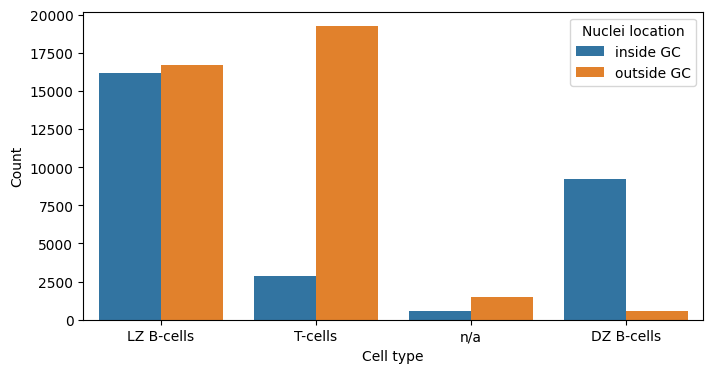

<IPython.core.display.Javascript object>

In [145]:
tmp = nuc_features.copy()
tmp.gc_status = tmp.gc_status.map({"positive": "inside GC", "negative": "outside GC"})

fig, ax = plt.subplots(figsize=[8, 4])
ax = sns.countplot(data=tmp, x="cell_type", hue="gc_status", ax=ax)
ax.set_xlabel("Cell type")
ax.set_ylabel("Count")
ax.legend(title="Nuclei location")
plt.show()

In [146]:
pd.DataFrame(nuc_features.groupby(["cell_type", "gc_status"]).count().label_id)

label_id
cell_type  gc_status          
DZ B-cells negative        582
           positive       9197
LZ B-cells negative      16684
           positive      16182
T-cells    negative      19232
           positive       2881
n/a        negative       1472
           positive        559

<IPython.core.display.Javascript object>

Going forward we are mostly interested in the cells inside the germinal centers, which is why we will subset the data set to those using the computed germinal center status.

In [147]:
gc_nuc_features = nuc_features.loc[nuc_features.gc_status == "positive"]
gc_nuc_features.index = np.array(list(gc_nuc_features.nuc_id))

<IPython.core.display.Javascript object>

---

### 2.2. T cell influence

In addition to the cell types we are interested in the chrometric states of the light and dark zone B cells within and outside the influence of T cells. To this end, we identify the cells within/outside a radius of 15 micron in the squared euclidean norm of the identified T cells within the germinal centers as we expect this to define the area where a physical contact of a T-cell and its neighboring cell could happen.

In [148]:
gc_nuc_features["spat_centroid_y"] = np.array(
    spatial_cord.loc[gc_nuc_features.index, "centroid-0"]
)
gc_nuc_features["spat_centroid_x"] = np.array(
    spatial_cord.loc[gc_nuc_features.index, "centroid-1"]
)

<IPython.core.display.Javascript object>

In addition to the physical contact T-cells could interact with their neighboring cells via cell-cell signaling. We thus obtain the set of Non-T-cell interactors as those where the centroid is at least 30 microns distant from the closest T-cell.

In [149]:
tcell_neigh_nuc_ids = tcell_radius_neighbors(
    dataset=gc_nuc_features,
    radius=15 / 0.3225,
    tcell_label="T-cells",
    cell_type_col="cell_type",
    id_col="nuc_id",
)

pot_tcell_neigh_nuc_ids = tcell_radius_neighbors(
    dataset=gc_nuc_features,
    radius=30 / 0.3225,
    tcell_label="T-cells",
    cell_type_col="cell_type",
    id_col="nuc_id",
)

gc_nuc_features.loc[:, "tcell_influence"] = "Non-T-cell interactors"

gc_nuc_features.loc[
    gc_nuc_features.loc[:, "nuc_id"].isin(pot_tcell_neigh_nuc_ids), "tcell_influence"
] = "potential T-cell interactors"

gc_nuc_features.loc[
    gc_nuc_features.loc[:, "nuc_id"].isin(tcell_neigh_nuc_ids), "tcell_influence"
] = "T-cell interactors"

<IPython.core.display.Javascript object>

In addition to the physical contact T-cells could interact with their neighboring cells via cell-cell signaling. We thus obtain the set of Non-T-cell interactors as those where the centroid is at least 30 microns distant from the closest T-cell.

The plot below shows a visual validation of the set threshold on the radius of influence.

In [150]:
tcell_infl_palette = dict(
    zip(
        [
            "T-cell interactors",
            "potential T-cell interactors",
            "Non-T-cell interactors",
        ],
        ["tab:orange", "tab:olive", "tab:purple"],
    )
)

<IPython.core.display.Javascript object>

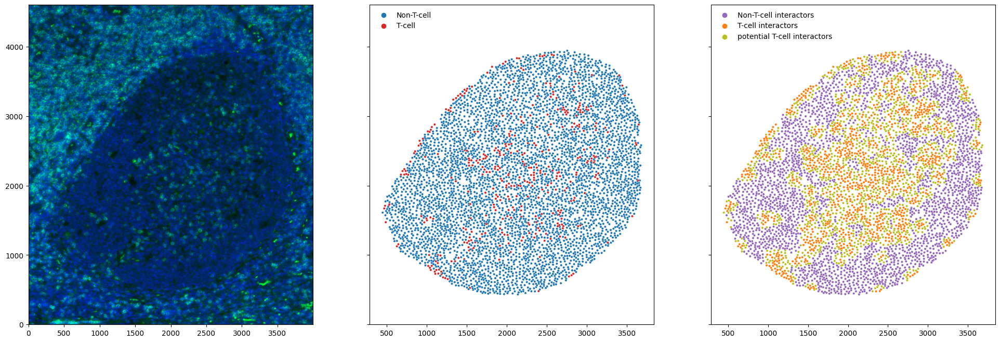

<IPython.core.display.Javascript object>

In [151]:
plt.style.use("default")
fig, ax = plot_tcell_labels(
    data=gc_nuc_features,
    spatial_cord=spatial_cord,
    image_dir="../../data/dataset1/images/raw/merged/",
    label_col="tcell_influence",
    cell_type_label_col="cell_type",
    tcell_label="T-cells",
    image_id=1,
    figsize=[24, 8],
    size=10,
    block_channel=0,
    palette1=["tab:blue", "tab:red"],
    palette2=tcell_infl_palette,
)
ax[1].legend(loc="upper left", frameon=False, title=None)
new_labels = ["Non-T-cell", "T-cell"]
for t, l in zip(ax[1].get_legend().texts, new_labels):
    t.set_text(l)

ax[2].legend(title=None, loc="upper left", frameon=False)
# for i in range(len(ax)):
#     ax[i].set_xlim([0, len()])
#     ax[i].set_ylim([0, 5000])

Note that thereby only neighboring cells are considered which leads to some T cells with no neighboring T cells to be called as outside the influence of T cells. Let us now look at the number of cells per cell type within/outside the influence of T cells in germinal centers.

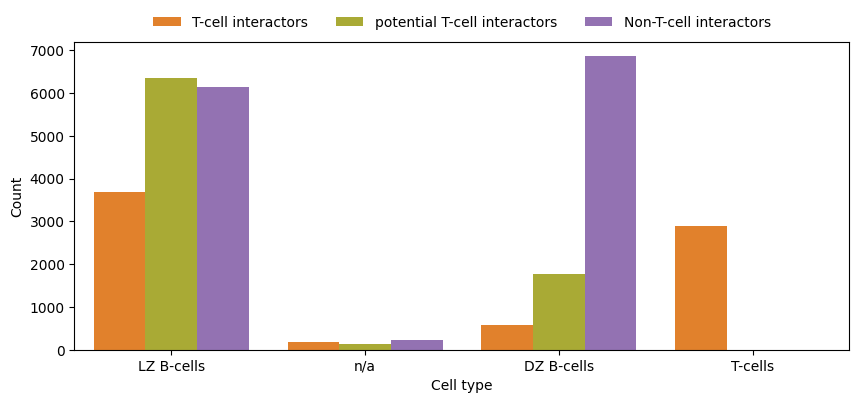

<IPython.core.display.Javascript object>

In [152]:
set_classic_style()

fig, ax = plt.subplots(figsize=[10, 4])
ax = sns.countplot(
    data=gc_nuc_features,
    x="cell_type",
    hue="tcell_influence",
    ax=ax,
    hue_order=[
        "T-cell interactors",
        "potential T-cell interactors",
        "Non-T-cell interactors",
    ],
    palette=tcell_infl_palette,
)
ax.set_xlabel("Cell type")
ax.set_ylabel("Count")
ax.legend(
    loc="lower center", bbox_to_anchor=(0.5, 1), ncol=3, title=None, frameon=False
)
plt.show()

In [153]:
pd.DataFrame(gc_nuc_features.groupby(["cell_type", "tcell_influence"]).count().label_id)

label_id
cell_type  tcell_influence                       
DZ B-cells Non-T-cell interactors            6855
           T-cell interactors                 570
           potential T-cell interactors      1772
LZ B-cells Non-T-cell interactors            6140
           T-cell interactors                3693
           potential T-cell interactors      6349
T-cells    T-cell interactors                2881
n/a        Non-T-cell interactors             230
           T-cell interactors                 191
           potential T-cell interactors       138

<IPython.core.display.Javascript object>

---

## 3. Analysis

After having assigned the cell identities we aim to assess the chrometric differences of those cells. In particular we are interested to answer the following two questions:
1. What are the chrometric differences between light and dark zone B cells in germinal centers?
2. Which possibly distinct chrometric phenotypes are observed in B cells within and outside of the influence of T cells in germinal centers?

To answer those questions we will use the same computational pipeline that includes the following steps:
1. The data set is cleaned by removing samples with missing features.
2. The data set is preprocessed by removing constant features and those that are correlated with a Pearson correlation coefficient of above 0.8.
3. A balanced subsample is obtained to avoid bias due to different class frequencies in the assessed classification task.
3. A random forest classifier is trained on the task to distinguish between positively and negatively labeled samples in 10-fold cross-validation scheme.
4. The feature importance of the random forest classifier is assessed to obtain an idea of the most differential chrometric features 
5. A t-test based marker screen is run to identify features significantly different between in the positively and negatively labeled samples.
6. Predictions are obtained for all nuclei using the random forest classifier trained on the first fold. The predictions are spatially compared to the true labels for selected germinal centers.

Since the first 2 steps of the pipeline do not depend on the assessed task, we perform them here in a unified way.

In [154]:
metacolumns = [
    "label_id",
    "weighted_centroid_y",
    "weighted_centroid_x",
    "centroid_y",
    "centroid_x",
    "bbox-0",
    "bbox-1",
    "bbox-2",
    "bbox-3",
    "nuc_id",
    "image",
    "orientation",
    "spat_centroid_y",
    "spat_centroid_x",
]
# drop_columns = set(metacolumns).union(set(list(gc_nuc_features.filter(regex="-").columns)))
drop_columns = metacolumns
cleaned_gc_nuc_features = clean_data(
    gc_nuc_features, drop_columns=list(drop_columns), index_col="nuc_id"
)

Removed 19 constant or features with missing values. Remaining: 186.
Removed additional 9 features. Remaining: 177.
Removed 0 samples with missing values. Remaining: 28819.


<IPython.core.display.Javascript object>

We first removed 19 constant features as well as 7 numeric metadata features.

In [155]:
filtered_gc_nuc_feat = remove_correlated_features(cleaned_gc_nuc_features, 0.8)

Removed 117/177 features with a Pearson correlation above 0.8. Remaining: 60


<IPython.core.display.Javascript object>

The correlation thresholding additionally removes 117 features.
Thus the final chrometric data set for the cell populations in the 10 germinal centers consist of 28,819 cells that are described by 60 nuclear features.

The following analysis will be using this feature set to solve the different classification tasks.

---

### 3.1. Light zone vs dark zone B cells

As described before, we first aim to distinguish between light and dark zone B cells based on the chrometric features.

In [156]:
from mycolorpy import colorlist as mcp

<IPython.core.display.Javascript object>

In [157]:
bcell_nuc_feats = filtered_gc_nuc_feat.loc[
    gc_nuc_features.loc[
        gc_nuc_features.loc[:, "cell_type"].isin(["LZ B-cells", "DZ B-cells"])
    ].index
]

bcell_labels = gc_nuc_features.loc[bcell_nuc_feats.index, "cell_type"]

<IPython.core.display.Javascript object>

#### Subsample the data set

We will now randomly subsample the data set such that we have an equal number of light and dark zone B cells, namely 9'197.

In [158]:
ru = RandomUnderSampler(random_state=seed)
res_bcell_nuc_feats, res_bc_nuc_labels = ru.fit_resample(bcell_nuc_feats, bcell_labels)
Counter(res_bc_nuc_labels)

Counter({'DZ B-cells': 9197, 'LZ B-cells': 9197})

<IPython.core.display.Javascript object>

#### Assess class separability using a Random Forest classifier in a 10-fold cross-validation setup.

In [159]:
rfc = RandomForestClassifier(
    n_estimators=100, n_jobs=8, class_weight="balanced", random_state=seed
)
n_folds = 10

<IPython.core.display.Javascript object>

In [160]:
fitted_bcell_rfcs, dz_vs_lz_confusion_matrix = run_cv_evaluation(
    model=rfc,
    n_folds=n_folds,
    features=res_bcell_nuc_feats,
    labels=res_bc_nuc_labels,
    random_state=seed,
)

<IPython.core.display.Javascript object>

The confusion matrix below shows the class separability of the 10-fold cross-validation approach distinguishing between light and dark-zone B cells.

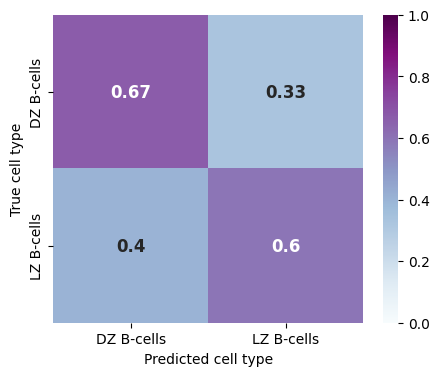

<IPython.core.display.Javascript object>

In [161]:
fig, ax = plot_cv_conf_mtx(
    dz_vs_lz_confusion_matrix,
    n_folds=n_folds,
    annot_kws={"size": 12, "weight": "bold"},
    figsize=[5, 4],
)
ax.set_xlabel("Predicted cell type")
ax.set_ylabel("True cell type")
plt.title("")
plt.show()
plt.close()

In [162]:
cv_bacs = cross_val_score(
    rfc,
    cv=n_folds,
    X=res_bcell_nuc_feats,
    y=res_bc_nuc_labels,
    scoring="balanced_accuracy",
    n_jobs=10,
)
print("Balanced accuracy: {} (+/- {})".format(np.mean(cv_bacs), np.std(cv_bacs)))

Balanced accuracy: 0.6255832781378625 (+/- 0.04187774312202623)


<IPython.core.display.Javascript object>

In addition to the average confusion matrix, we validate that the performance of the classifier is significantly better than chance by visualizing the ROC curves in a 10-fold cross-validation setup.

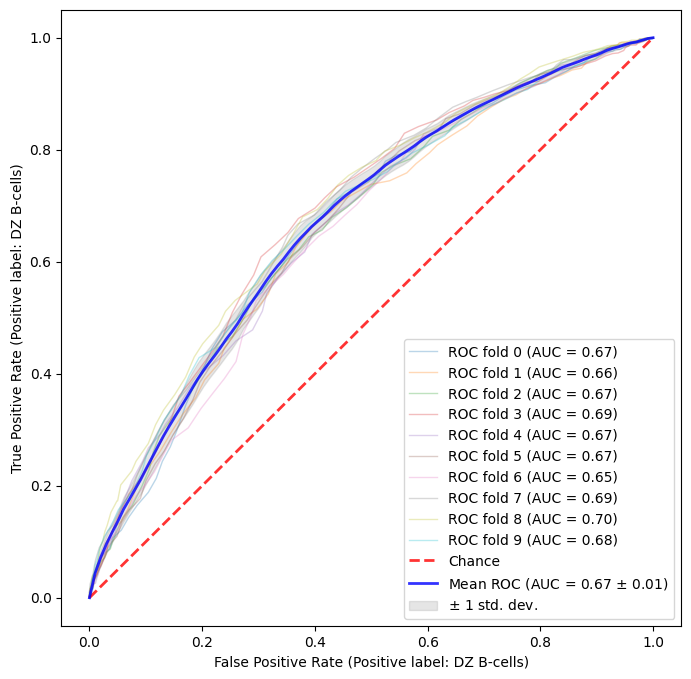

<IPython.core.display.Javascript object>

In [163]:
fig, ax, _ = plot_roc_for_stratified_cv(
    X=np.array(res_bcell_nuc_feats),
    y=np.array(res_bc_nuc_labels),
    classifier=rfc,
    n_splits=n_folds,
    title="",
    random_state=seed,
    pos_label="DZ B-cells",
)

#### Visualization of the model predictions

To further qualitatively show the accuracy of the inferred model to distinguish light zone and dark zone B cells, we here plot the predictions for a randomly selected image.

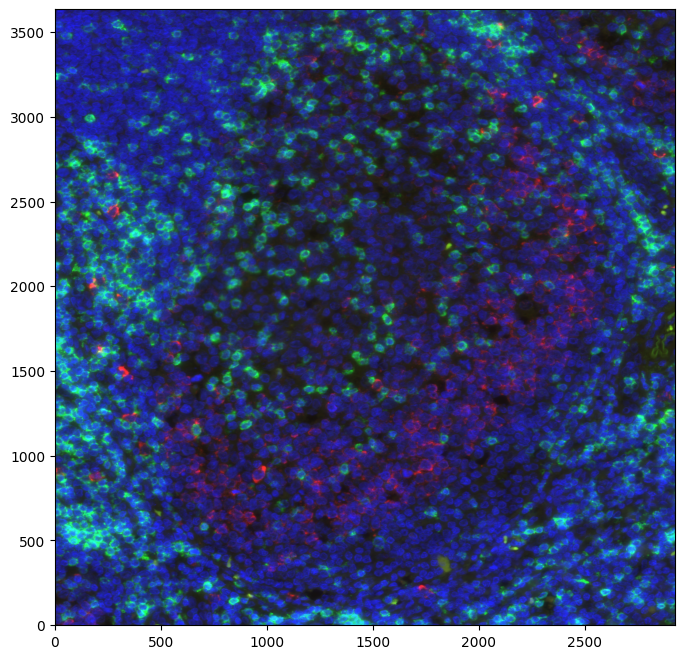

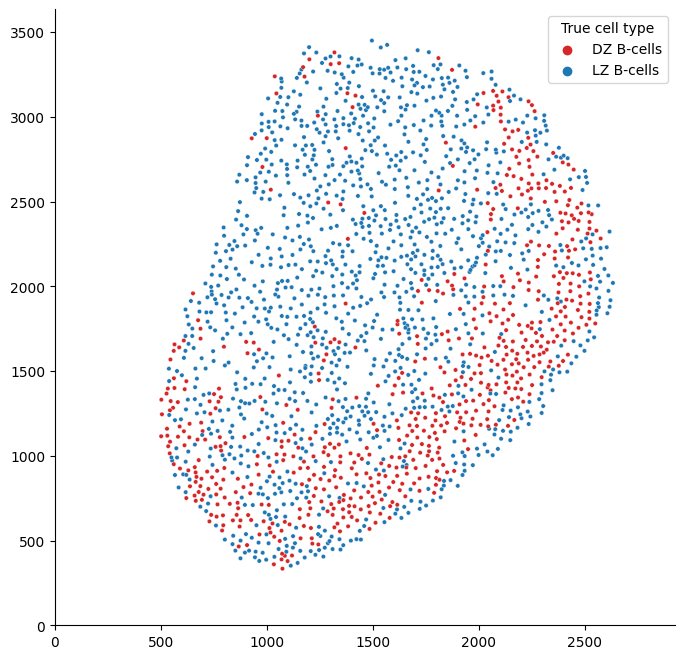

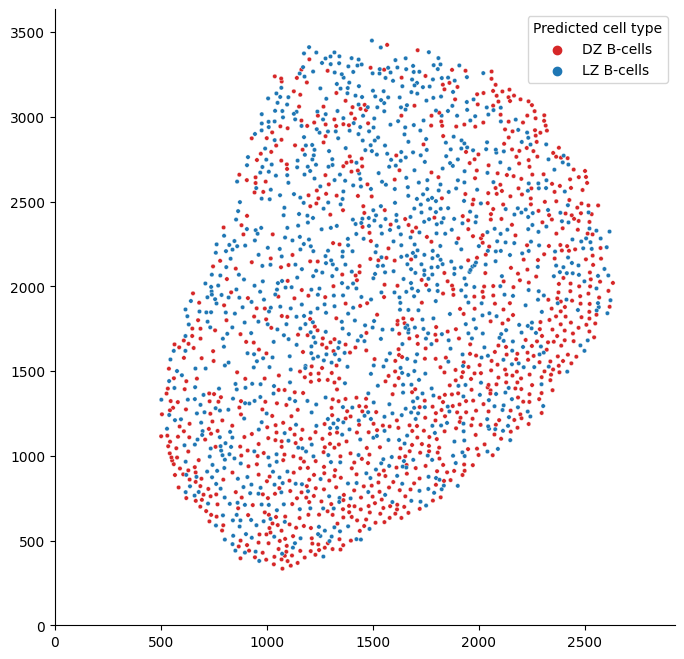

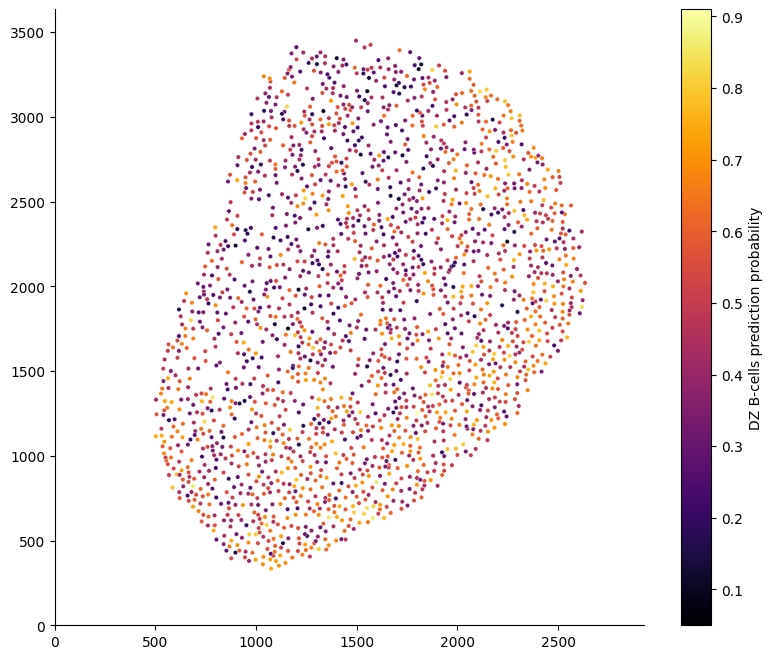

<IPython.core.display.Javascript object>

In [164]:
color_dict = {"LZ B-cells": "tab:blue", "DZ B-cells": "tab:red", "T-cells": "tab:green"}
color_palette = sns.set_palette(sns.color_palette(list(color_dict.values())))
plt.style.use("default")

figs, axs = plot_predictions(
    model=rfc,
    data=gc_nuc_features,
    spatial_cord=spatial_cord,
    image_dir="../../data/dataset1/images/raw/merged/",
    selected_features=list(res_bcell_nuc_feats.columns),
    selected_labels=fitted_bcell_rfcs[0].classes_,
    label_col="cell_type",
    pos_label="DZ B-cells",
    image_id=10,
    figsize=[8, 8],
    train_on_balanced_subsample=True,
    random_state=1234,
    n_folds=10,
    palette1=["tab:red", "tab:blue"],
    palette2="inferno",
    s=10,
)

axs[1].legend(title="True cell type", loc="upper right")
axs[2].legend(title="Predicted cell type", loc="upper right")
for ax in axs:
    ax.set_xlabel("")
    ax.set_ylabel("")
plt.show()
plt.close()

#### Assess the different chrometric phenotypes of the cells

We will now choose the classifier fit on the first data split and assess the implicit feature importance that are were most discriminative in the random forest classifier to distinguish between those cell types.

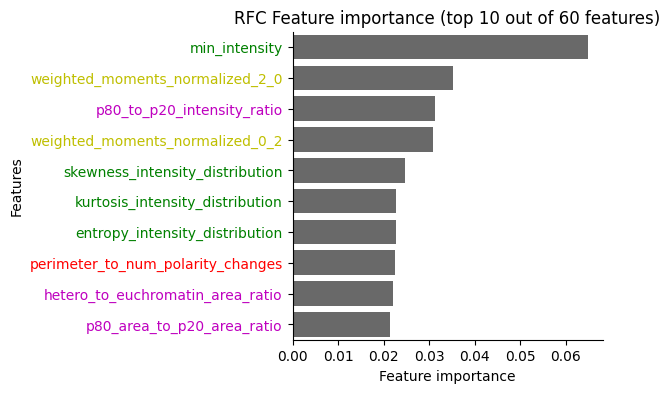

<IPython.core.display.Javascript object>

In [165]:
set_classic_style()

fitted_rfc = fitted_bcell_rfcs[0]
plot_feature_importance(
    importance=fitted_rfc.feature_importances_,
    names=res_bcell_nuc_feats.columns,
    model_type="RFC ",
    n_features=10,
    figsize=[4, 4],
    feature_color_dict=feature_color_dict,
)

cell_type_feat_import = pd.DataFrame(
    list(zip(res_bcell_nuc_feats.columns, fitted_rfc.feature_importances_)),
    columns=["feature", "importance"],
)

We see that most discriminative features are absolute intensity features as well as texture features. We will compare that now with the results of t-test based marker screen. Importantly, here we will use the complete data set and not just the subsampled version.

In [166]:
celltype_marker_results = find_markers(
    data=bcell_nuc_feats, labels=bcell_labels, test="welch"
)
dz_bcell_marker_results = celltype_marker_results.loc[
    celltype_marker_results.label == "DZ B-cells"
]
dz_bcell_marker_results = dz_bcell_marker_results.loc[
    dz_bcell_marker_results.adjusted_pval < 0.05
]
dz_bcell_marker_results

Run marker screen: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  4.45it/s]


,label,marker,fc,abs_delta_fc,pval,adjusted_pval
11,DZ B-cells,min_intensity,1.267751,0.267751,0.000000e+00,0.000000e+00
25,DZ B-cells,weighted_moments_normalized_2_0,0.807137,0.192863,2.822343e-232,8.467028e-231
27,DZ B-cells,weighted_moments_normalized_2_2,0.620412,0.379588,2.747260e-211,5.494520e-210
21,DZ B-cells,weighted_moments_normalized_0_2,0.824106,0.175894,2.634875e-181,3.952313e-180
15,DZ B-cells,p80_to_p20_intensity_ratio,0.963119,0.036881,3.833891e-126,4.600670e-125
40,DZ B-cells,weighted_moments_hu_1,0.599895,0.400105,6.527751e-78,6.527751e-77
41,DZ B-cells,weighted_moments_hu_2,0.503274,0.496726,2.915954e-32,2.499389e-31
14,DZ B-cells,entropy_intensity_distribution,1.017035,0.017035,6.186347e-32,4.639761e-31
18,DZ B-cells,glcm_homogeneity_1px,0.979366,0.020634,1.095980e-18,7.306535e-18
42,DZ B-cells,weighted_moments_hu_3,0.437089,0.562911,3.767930e-17,2.260758e-16


<IPython.core.display.Javascript object>

We see that as before the intensity and texture features are found to be the most significant although even a couple shape and size features are found to be significantly different between the light and darkzone B cells  with respect to a 0.05 confidence level after adjusting for multiple testing using the Bonferroni-Holm procedure. In summary the DZ B-cells feature overall higher levels of minimal chromatin condensation, less regular texture ad slightly enlarged and less convex shaped nuclei compared to the LZ B-cells.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

LZ B-cells vs. DZ B-cells: Welch's t-test independent samples, P_val:0.000e+00 t=-4.287e+01


Text(-16.65277777777778, 0.5, '')

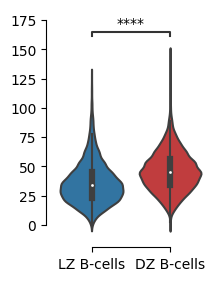

<IPython.core.display.Javascript object>

In [167]:
fig, ax = plt.subplots(figsize=[2, 3])
ax = sns.violinplot(
    data=gc_nuc_features.loc[bcell_nuc_feats.index],
    x="cell_type",
    y="min_intensity",
    palette=["tab:blue", "tab:red"],
)
annotator = Annotator(
    ax,
    [("DZ B-cells", "LZ B-cells")],
    data=gc_nuc_features.loc[bcell_nuc_feats.index],
    x="cell_type",
    y="min_intensity",
    plot="violinplot",
)
annotator.configure(test="t-test_welch", text_format="star", loc="inside")
annotator.apply_and_annotate()
sns.despine(trim=True, offset=5)
ax.set_xlabel("")
ax.set_ylabel("")

---

--- 

### 3.2. B cells and T cell interaction

While the previous analysis has focussed on understanding the different phenotypes of light and dark zone B cells in germinal centers in general, we are now interested in assessing whether or not there is a difference in the population of B cells in those germinal centers with respect to the populations within the influence of T cells and outside those.

In [168]:
bcell_nuc_feats = filtered_gc_nuc_feat.loc[
    gc_nuc_features.loc[
        gc_nuc_features.loc[:, "cell_type"].isin(["LZ B-cells", "DZ B-cells"])
    ].index
]

tcell_influence_labels = gc_nuc_features.loc[bcell_nuc_feats.index, "tcell_influence"]

<IPython.core.display.Javascript object>

#### Subsample the data set

We will now randomly subsample the data set such that we have an equal number of B cells within and outside the influence zone of T cells.

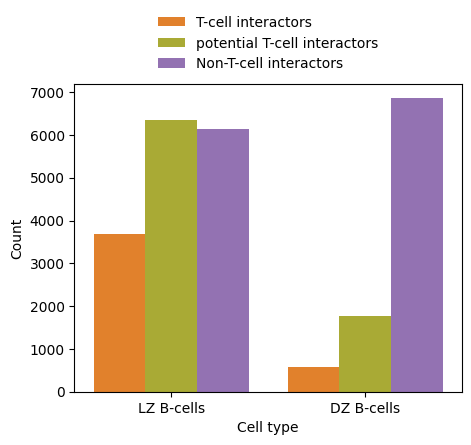

<IPython.core.display.Javascript object>

In [169]:
fig, ax = plt.subplots(figsize=[5, 4])
ax = sns.countplot(
    data=gc_nuc_features.loc[bcell_nuc_feats.index],
    x="cell_type",
    hue="tcell_influence",
    ax=ax,
    hue_order=[
        "T-cell interactors",
        "potential T-cell interactors",
        "Non-T-cell interactors",
    ],
    palette=tcell_infl_palette,
    # width=0.5,
)
ax.legend(
    loc="lower center", bbox_to_anchor=(0.5, 1), ncol=1, title=None, frameon=False
)
ax.set_xlabel("Cell type")
ax.set_ylabel("Count")
plt.show()

To split the data obtain a balanced subset of the data such that we have an equal number of T-cell interacting B-cells and those that do not interact with T-cells. We hereby exclude the potential interactors and also do not take distinguish between the dark and light zone B-cells.

In [170]:
tcell_category_mask = tcell_influence_labels.isin(
    ["T-cell interactors", "Non-T-cell interactors"]
)
selection_idc = tcell_category_mask.loc[tcell_category_mask == True].index

ru = RandomUnderSampler(random_state=seed)
sample_idc, _ = ru.fit_resample(
    np.array(selection_idc).reshape(-1, 1), tcell_influence_labels.loc[selection_idc]
)
sample_idc = sample_idc.flatten()

<IPython.core.display.Javascript object>

In [171]:
all_bcell_feats = gc_nuc_features.loc[bcell_nuc_feats.index]
# lz_tcell_infl_bcells = all_bcell_feats.loc[
#     (all_bcell_feats.cell_type == "LZ B-cells")
#     & (all_bcell_feats.tcell_influence == "T-cell interactors")
# ]
# lz_tcell_noninfl_bcells = all_bcell_feats.loc[
#     (all_bcell_feats.cell_type == "LZ B-cells")
#     & (all_bcell_feats.tcell_influence == "Non-T-cell interactors")
# ]
# dz_tcell_infl_bcells = all_bcell_feats.loc[
#     (all_bcell_feats.cell_type == "DZ B-cells")
#     & (all_bcell_feats.tcell_influence == "T-cell interactors")
# ]
# dz_tcell_noninfl_bcells = all_bcell_feats.loc[
#     (all_bcell_feats.cell_type == "DZ B-cells")
#     & (all_bcell_feats.tcell_influence == "Non-T-cell interactors")
# ]

<IPython.core.display.Javascript object>

In [172]:
# lz_sample_count = min(len(lz_tcell_infl_bcells), len(lz_tcell_noninfl_bcells))
# dz_sample_count = min(len(dz_tcell_infl_bcells), len(dz_tcell_infl_bcells))

<IPython.core.display.Javascript object>

In [173]:
# np.random.seed(seed)
# sample_idc = []
# sample_idc += list(
#     np.random.choice(
#         list(lz_tcell_infl_bcells.index), size=lz_sample_count, replace=False
#     )
# )
# sample_idc += list(
#     np.random.choice(
#         list(lz_tcell_noninfl_bcells.index), size=lz_sample_count, replace=False
#     )
# )
# sample_idc += list(
#     np.random.choice(
#         list(dz_tcell_infl_bcells.index), size=dz_sample_count, replace=False
#     )
# )
# sample_idc += list(
#     np.random.choice(
#         list(dz_tcell_noninfl_bcells.index), size=dz_sample_count, replace=False
#     )
# )

<IPython.core.display.Javascript object>

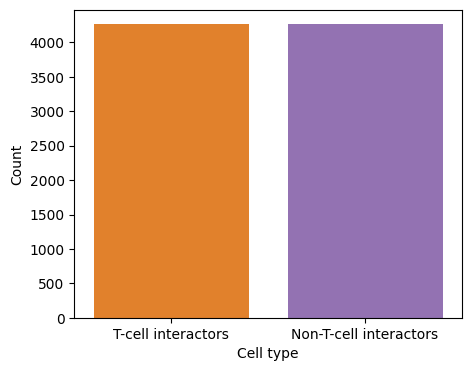

<IPython.core.display.Javascript object>

In [174]:
fig, ax = plt.subplots(figsize=[5, 4])
ax = sns.countplot(
    data=gc_nuc_features.loc[sample_idc],
    x="tcell_influence",
    ax=ax,
    order=["T-cell interactors", "Non-T-cell interactors"],
    palette=tcell_infl_palette,
    # width=0.5,
)
ax.set_xlabel("Cell type")
ax.set_ylabel("Count")
plt.show()

In [175]:
gc_nuc_features.loc[sample_idc].groupby(
    ["cell_type", "tcell_influence"]
).count().label_id

cell_type   tcell_influence       
DZ B-cells  Non-T-cell interactors    2252
            T-cell interactors         570
LZ B-cells  Non-T-cell interactors    2011
            T-cell interactors        3693
Name: label_id, dtype: int64

<IPython.core.display.Javascript object>

The above plot validates that we have no an equal representation of cells within and outside of the influence of T cells among the light- and dark-zone B cells.

In [176]:
res_bcell_tcell_infl_nuc_feats = bcell_nuc_feats.loc[sample_idc]
res_tcell_infl_labels = tcell_influence_labels.loc[sample_idc]
res_tcell_infl_bcell_labels = bcell_labels.loc[sample_idc]

<IPython.core.display.Javascript object>

We next investigate how different the T-cell interacting B cells are compared to those not interacting with T-cells first in both the light and dark-zone together and then individually. To this end, we first assess how well a RandomForest classifier can predict if a B cell interacts with a T cell and then run a screen to identify chrometric features that are significantly different between those two types of B cells.

#### 2.2.1. T cell influence on all LZ and DZ B cells.

To assess the performance of a RandomForest classifier we use a 10-fold stratified cross-validation setup.

In [177]:
rfc = RandomForestClassifier(
    n_estimators=100, n_jobs=8, class_weight="balanced", random_state=seed
)
n_folds = 10

<IPython.core.display.Javascript object>

In [178]:
fitted_tcell_infl_rfcs, tcell_infl_confusion_matrix = run_cv_evaluation(
    model=rfc,
    n_folds=n_folds,
    features=res_bcell_tcell_infl_nuc_feats,
    labels=res_tcell_infl_labels,
    random_state=seed,
)

<IPython.core.display.Javascript object>

The confusion matrix below shows the class separability of the 10-fold cross-validation approach distinguishing B cells within and outside the influence of T cells inside the germinal centers. The relatively low performance implies that the chrometric profiles of B cells in general do not differ at large-scale depending on whether or not they are within the influence zone of T cells or not.

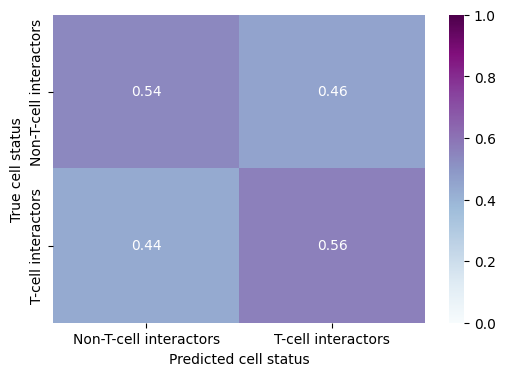

<IPython.core.display.Javascript object>

In [179]:
fig, ax = plot_cv_conf_mtx(tcell_infl_confusion_matrix, n_folds=n_folds)
ax.set_xlabel("Predicted cell status")
ax.set_ylabel("True cell status")
plt.title("")
plt.show()
plt.close()

In [180]:
cv_bacs = cross_val_score(
    rfc,
    cv=n_folds,
    X=res_bcell_tcell_infl_nuc_feats,
    y=res_tcell_infl_labels,
    scoring="balanced_accuracy",
    n_jobs=10,
)
print("Balanced accuracy: {} (+/- {})".format(np.mean(cv_bacs), np.std(cv_bacs)))

Balanced accuracy: 0.544219964596321 (+/- 0.016392883473961742)


<IPython.core.display.Javascript object>

This is further validated by an additional assessment of the area under the ROC curve that we equally evaluate in 10-fold cross-validation setup.

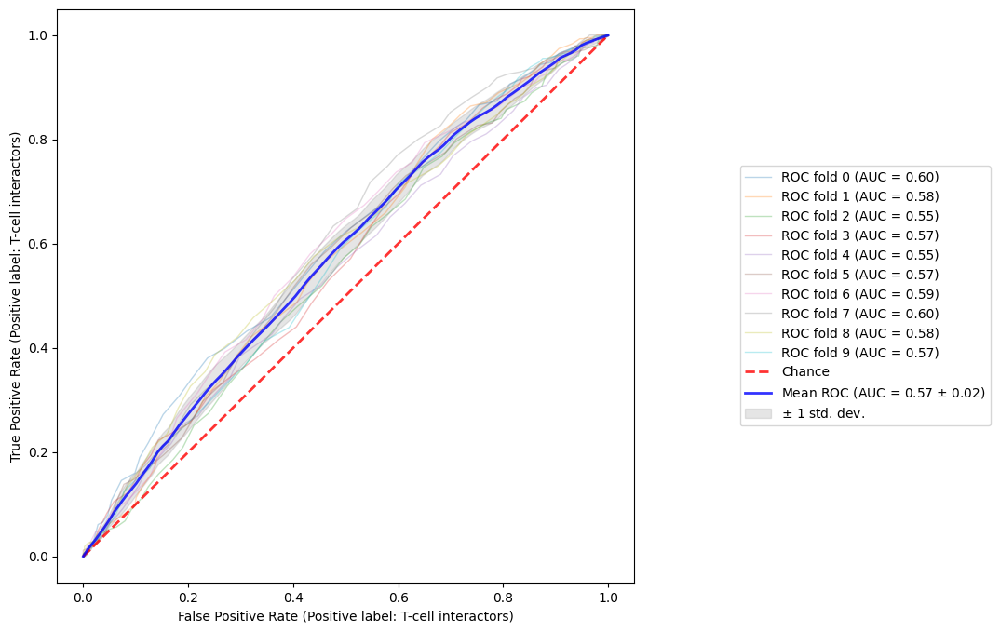

<IPython.core.display.Javascript object>

In [181]:
fig, ax, _ = plot_roc_for_stratified_cv(
    X=np.array(res_bcell_tcell_infl_nuc_feats),
    y=np.array(res_tcell_infl_labels),
    classifier=rfc,
    n_splits=n_folds,
    title="",
    random_state=seed,
    pos_label="T-cell interactors",
)
ax.legend(loc="center", bbox_to_anchor=(1.4, 0.5), ncol=1, title=None, frameon=True)

#### Visualization of the model predictions

To further qualitatively show the accuracy of the inferred model to distinguish light zone and dark zone B cells, we here plot the predictions for a randomly selected image.

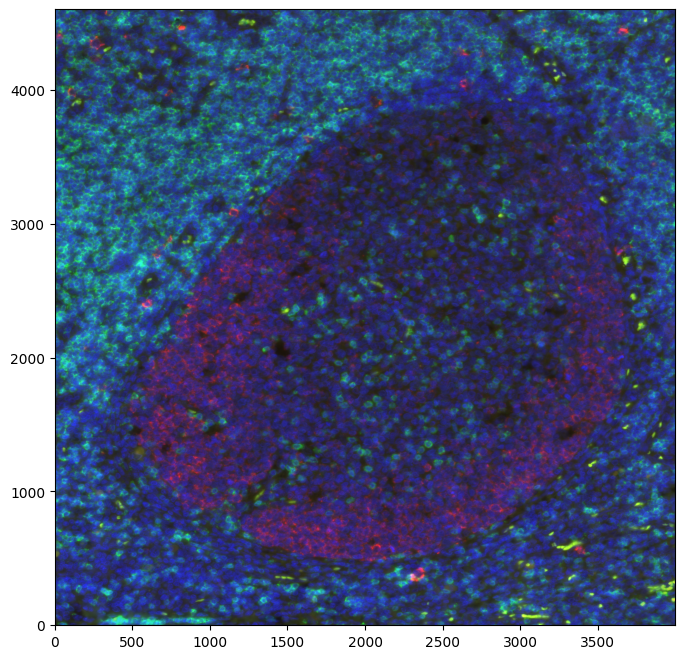

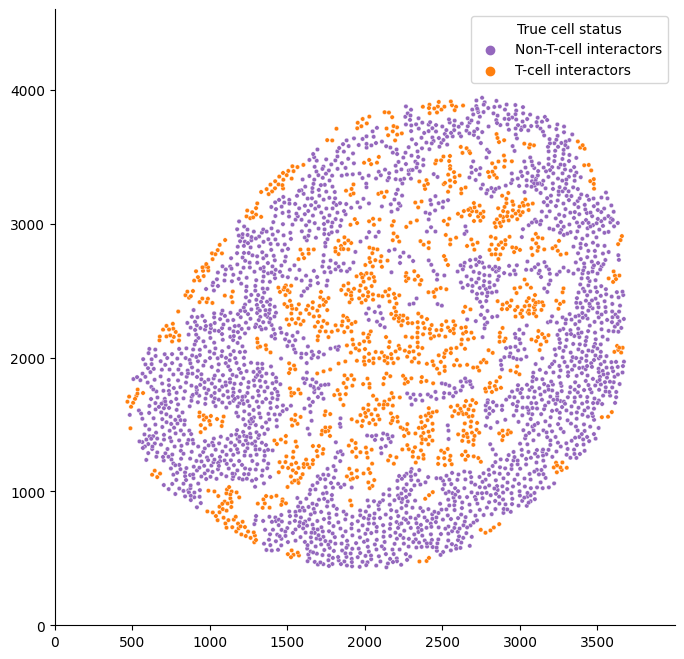

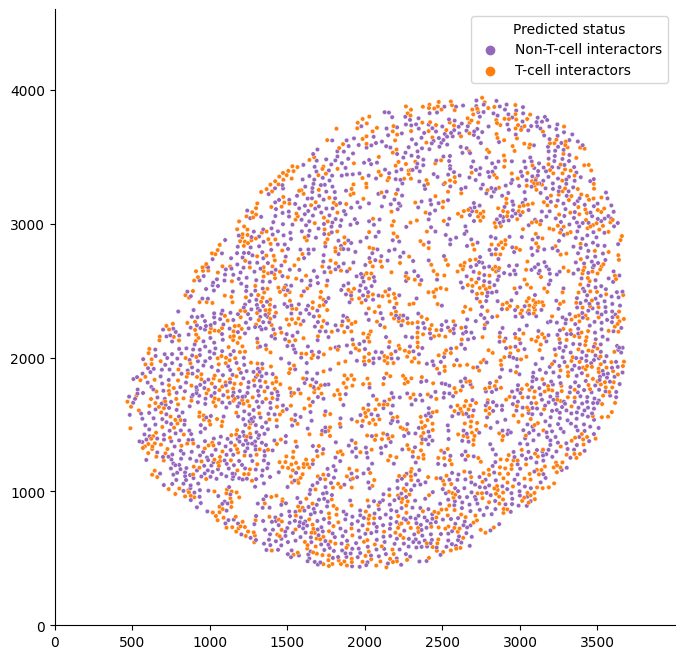

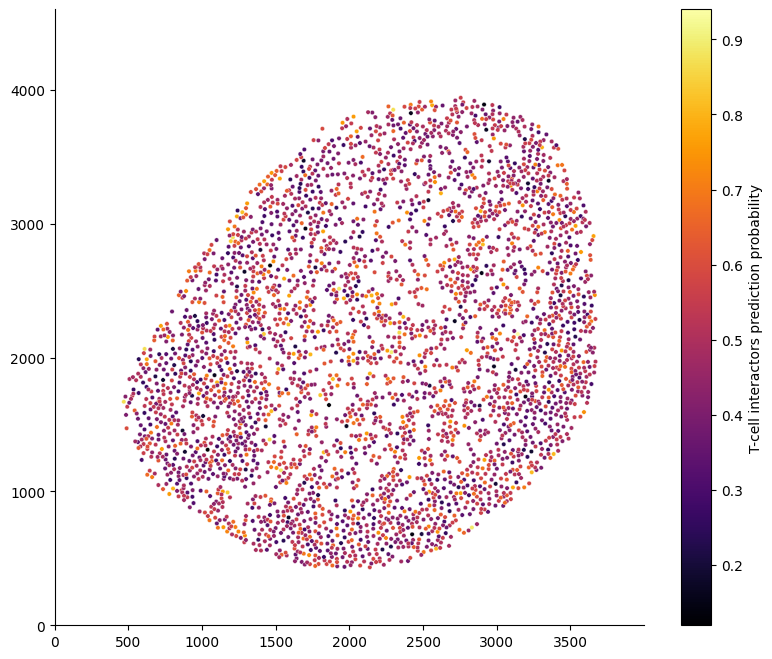

<IPython.core.display.Javascript object>

In [182]:
plt.style.use("default")
figs, axs = plot_predictions(
    model=rfc,
    data=gc_nuc_features,
    spatial_cord=spatial_cord,
    image_dir="../../data/dataset1/images/raw/merged/",
    selected_features=list(res_bcell_nuc_feats.columns),
    selected_labels=fitted_tcell_infl_rfcs[0].classes_,
    label_col="tcell_influence",
    pos_label="T-cell interactors",
    image_id=1,
    figsize=[8, 8],
    train_on_balanced_subsample=True,
    random_state=1234,
    palette1=tcell_infl_palette,
    palette2="inferno",
    s=10,
)

axs[1].legend(title="True cell status", loc="upper right")
axs[2].legend(title="Predicted status", loc="upper right")
for ax in axs:
    ax.set_xlabel("")
    ax.set_ylabel("")

As before this validates the limited classification performance of the model to discriminate between B cells inside and outside the influence of T cells.

#### Assess the different chrometric phenotypes of the cells

We will now choose the classifier fit on the first data split and assess the implicit feature importance that are were most discriminative in the random forest classifier to distinguish between those cell types.

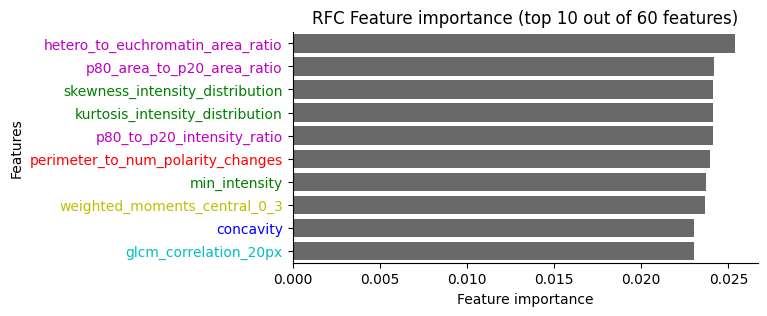

<IPython.core.display.Javascript object>

In [183]:
set_classic_style()


fitted_rfc = fitted_tcell_infl_rfcs[0]
plot_feature_importance(
    importance=fitted_rfc.feature_importances_,
    names=res_bcell_nuc_feats.columns,
    model_type="RFC ",
    n_features=10,
    figsize=[6, 3],
    feature_color_dict=feature_color_dict,
)

cell_type_feat_import = pd.DataFrame(
    list(zip(res_bcell_nuc_feats.columns, fitted_rfc.feature_importances_)),
    columns=["feature", "importance"],
)

We see that most discriminative features are size and texture features alongside a couple moment features.

In [184]:
celltype_marker_results = find_markers(
    data=bcell_nuc_feats, labels=tcell_influence_labels, test="welch"
)
tcell_infl_bcell_marker_results = celltype_marker_results.loc[
    celltype_marker_results.label == "T-cell interactors"
]
tcell_infl_bcell_marker_results = tcell_infl_bcell_marker_results.loc[
    tcell_infl_bcell_marker_results.adjusted_pval < 0.05
]
tcell_infl_bcell_marker_results

Run marker screen: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00,  4.34it/s]


,label,marker,fc,abs_delta_fc,pval,adjusted_pval
0,T-cell interactors,min_caliper_distance,0.931967,0.068033,5.863476e-39,3.518085e-37
2,T-cell interactors,std_radial_distance,0.913657,0.086343,3.895578e-24,8.765050e-23
15,T-cell interactors,p80_to_p20_intensity_ratio,0.982642,0.017358,1.241337e-17,1.862006e-16
11,T-cell interactors,min_intensity,1.037724,0.037724,1.685880e-06,1.785050e-05
14,T-cell interactors,entropy_intensity_distribution,0.991340,0.008660,2.800086e-06,2.800086e-05
19,T-cell interactors,glcm_homogeneity_20px,1.062722,0.062722,1.208654e-05,1.087788e-04
5,T-cell interactors,std_curvature,1.009016,0.009016,2.746796e-05,2.247378e-04
12,T-cell interactors,kurtosis_intensity_distribution,0.676549,0.323451,6.877827e-05,5.382647e-04
9,T-cell interactors,num_prominant_neg_curvature,0.933977,0.066023,2.035374e-04,1.465469e-03
18,T-cell interactors,glcm_homogeneity_1px,0.989303,0.010697,4.271075e-04,2.745691e-03


<IPython.core.display.Javascript object>

In [185]:
tcell_infl_bcell_marker_results = celltype_marker_results.loc[
    celltype_marker_results.label == "Non-T-cell interactors"
]
tcell_infl_bcell_marker_results = tcell_infl_bcell_marker_results.loc[
    tcell_infl_bcell_marker_results.adjusted_pval < 0.05
]
tcell_infl_bcell_marker_results

,label,marker,fc,abs_delta_fc,pval,adjusted_pval
11,Non-T-cell interactors,min_intensity,1.083452,0.083452,4.222344e-44,3.800110e-42
21,Non-T-cell interactors,weighted_moments_normalized_0_2,0.924182,0.075818,8.426369e-30,3.791866e-28
25,Non-T-cell interactors,weighted_moments_normalized_2_0,0.931720,0.068280,4.013942e-25,1.032156e-23
27,Non-T-cell interactors,weighted_moments_normalized_2_2,0.853699,0.146301,3.832130e-22,7.664261e-21
2,Non-T-cell interactors,std_radial_distance,1.050905,0.050905,3.093471e-13,4.283268e-12
0,Non-T-cell interactors,min_caliper_distance,1.027249,0.027249,9.590797e-11,1.233103e-09
40,Non-T-cell interactors,weighted_moments_hu_1,0.849401,0.150599,1.850747e-08,2.082091e-07
13,Non-T-cell interactors,skewness_intensity_distribution,0.746970,0.253030,7.823598e-06,7.411829e-05
14,Non-T-cell interactors,entropy_intensity_distribution,1.005942,0.005942,1.826329e-05,1.565425e-04
15,Non-T-cell interactors,p80_to_p20_intensity_ratio,0.993733,0.006267,7.872714e-05,5.904536e-04


<IPython.core.display.Javascript object>

----

#### 2.2.1. T cell influence on DZ B cells.

In [186]:
res_dz_bcell_tcell_infl_nuc_feats = res_bcell_tcell_infl_nuc_feats.loc[
    res_tcell_infl_bcell_labels == "DZ B-cells"
]
res_dz_tcell_infl_labels = res_tcell_infl_labels.loc[
    res_tcell_infl_bcell_labels == "DZ B-cells"
]

<IPython.core.display.Javascript object>

To assess the performance of a RandomForest classifier we use a 10-fold stratified cross-validation setup.

In [187]:
rfc = RandomForestClassifier(
    n_estimators=100, n_jobs=8, class_weight="balanced", random_state=seed
)
n_folds = 10

<IPython.core.display.Javascript object>

In [188]:
fitted_dz_tcell_infl_rfcs, dz_tcell_infl_confusion_matrix = run_cv_evaluation(
    model=rfc,
    n_folds=n_folds,
    features=np.array(res_dz_bcell_tcell_infl_nuc_feats),
    labels=np.array(res_dz_tcell_infl_labels),
    random_state=seed,
)

<IPython.core.display.Javascript object>

The confusion matrix below shows the class separability of the 10-fold cross-validation approach distinguishing B cells within and outside the influence of T cells inside the dark-zone of the germinal centers. As before when in addition to the DZ B-cells LZ B-cells were used we observe a fairly low prediction accuracy.

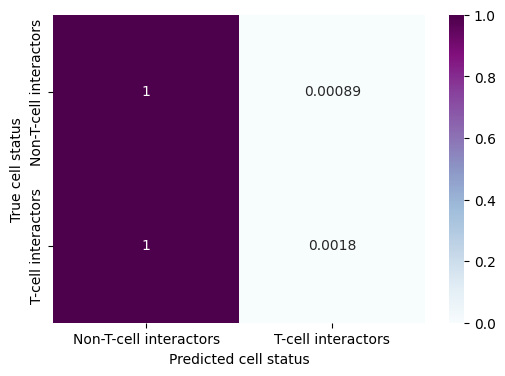

<IPython.core.display.Javascript object>

In [189]:
fig, ax = plot_cv_conf_mtx(dz_tcell_infl_confusion_matrix, n_folds=n_folds)
ax.set_xlabel("Predicted cell status")
ax.set_ylabel("True cell status")
plt.title("")
plt.show()

This is further validated by an additional assessment of the area under the ROC curve that we equally evaluate in 10-fold cross-validation setup.

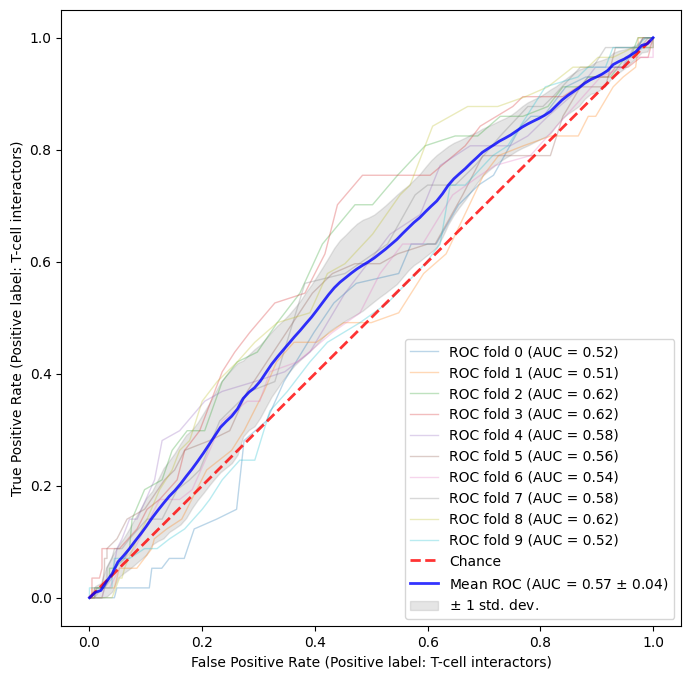

<IPython.core.display.Javascript object>

In [190]:
fig, ax, _ = plot_roc_for_stratified_cv(
    X=np.array(res_dz_bcell_tcell_infl_nuc_feats),
    y=np.array(res_dz_tcell_infl_labels),
    classifier=rfc,
    n_splits=n_folds,
    title="",
    random_state=seed,
    pos_label="T-cell interactors",
)

In fact when assessing the area under the ROC curve we obser that the performance is not significantly larger than random chance suggesting that within the DZ B-cell population we do not see a different chrometric signature in those B cells close to T-cells compared to those more distant.

A marker screen shows that there are also only few features related to the size of the nuclei that differ signficantly between DZ B-cells within vs. outside the influence of T-cells.

In [191]:
dz_bcell_nuc_feats = bcell_nuc_feats.loc[bcell_labels == "DZ B-cells"]
dz_tcell_influence_labels = tcell_influence_labels.loc[bcell_labels == "DZ B-cells"]

celltype_marker_results = find_markers(
    data=dz_bcell_nuc_feats, labels=dz_tcell_influence_labels, test="welch"
)
tcell_dz_infl_bcell_marker_results = celltype_marker_results.loc[
    celltype_marker_results.label == "T-cell interactors"
]
tcell_dz_infl_bcell_marker_results = tcell_dz_infl_bcell_marker_results.loc[
    tcell_dz_infl_bcell_marker_results.adjusted_pval < 0.05
]
tcell_dz_infl_bcell_marker_results

Run marker screen: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00,  6.61it/s]


,label,marker,fc,abs_delta_fc,pval,adjusted_pval
2,T-cell interactors,std_radial_distance,0.882005,0.117995,4.490687e-09,2.694412e-07
0,T-cell interactors,min_caliper_distance,0.928896,0.071104,5.970489e-08,2.149376e-06
15,T-cell interactors,p80_to_p20_intensity_ratio,0.986474,0.013526,3.580548e-03,3.622267e-02
18,T-cell interactors,glcm_homogeneity_1px,0.977933,0.022067,3.622267e-03,3.622267e-02
4,T-cell interactors,area_bbarea,1.011723,0.011723,4.735769e-03,4.262193e-02
58,T-cell interactors,moments_hu_2,0.802204,0.197796,4.660303e-03,4.262193e-02


<IPython.core.display.Javascript object>

In particular, we only observe size features to differ significantly between DZ B-cells within and outside the influence of T-cells.

----

#### 2.2.1. T cell influence on LZ B cells.

In [192]:
res_lz_bcell_tcell_infl_nuc_feats = res_bcell_tcell_infl_nuc_feats.loc[
    res_tcell_infl_bcell_labels == "LZ B-cells"
]
res_lz_tcell_infl_labels = res_tcell_infl_labels.loc[
    res_tcell_infl_bcell_labels == "LZ B-cells"
]

<IPython.core.display.Javascript object>

To assess the performance of a RandomForest classifier we use a 10-fold stratified cross-validation setup.

In [193]:
rfc = RandomForestClassifier(
    n_estimators=100, n_jobs=8, class_weight="balanced", random_state=seed
)
n_folds = 10

<IPython.core.display.Javascript object>

In [194]:
fitted_lz_tcell_infl_rfcs, lz_tcell_infl_confusion_matrix = run_cv_evaluation(
    model=rfc,
    n_folds=n_folds,
    features=np.array(res_lz_bcell_tcell_infl_nuc_feats),
    labels=np.array(res_lz_tcell_infl_labels),
    random_state=seed,
)

<IPython.core.display.Javascript object>

The confusion matrix below shows the class separability of the 10-fold cross-validation approach distinguishing B cells within and outside the influence of T cells inside the dark-zone of the germinal centers. As before when in addition to the DZ B-cells LZ B-cells were used we observe a fairly low prediction accuracy.

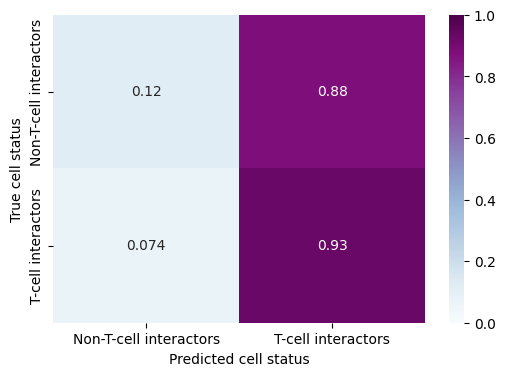

<IPython.core.display.Javascript object>

In [195]:
fig, ax = plot_cv_conf_mtx(lz_tcell_infl_confusion_matrix, n_folds=n_folds)
ax.set_xlabel("Predicted cell status")
ax.set_ylabel("True cell status")
plt.title("")
plt.show()

This is further validated by an additional assessment of the area under the ROC curve that we equally evaluate in 10-fold cross-validation setup.

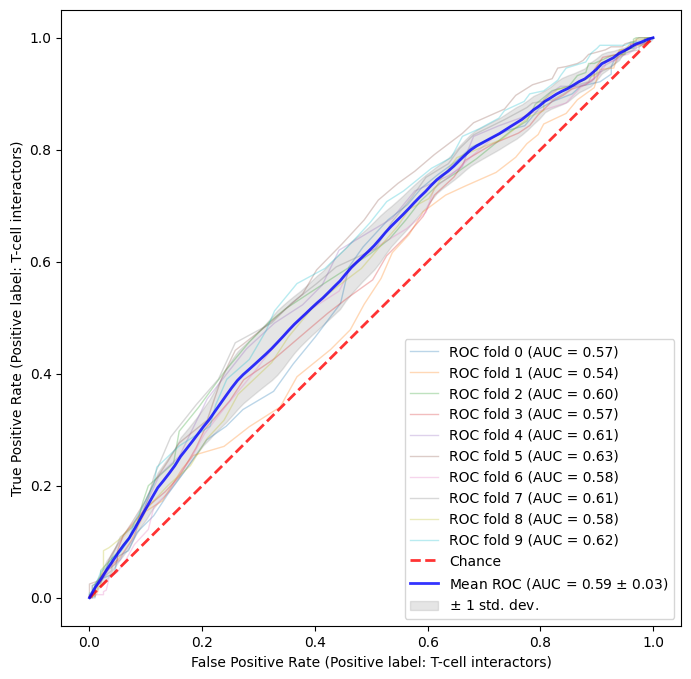

<IPython.core.display.Javascript object>

In [196]:
fig, ax, _ = plot_roc_for_stratified_cv(
    X=np.array(res_lz_bcell_tcell_infl_nuc_feats),
    y=np.array(res_lz_tcell_infl_labels),
    classifier=rfc,
    n_splits=n_folds,
    title="",
    random_state=seed,
    pos_label="T-cell interactors",
)

In fact when assessing the area under the ROC curve we obser that the performance is not significantly larger than random chance suggesting that within the DZ B-cell population we do not see a different chrometric signature in those B cells close to T-cells compared to those more distant.

A marker screen shows that there are also only few features related to the chromatin content of the nuclei that differ signficantly between DZ B-cells within vs. outside the influence of T-cells.

In [197]:
lz_bcell_nuc_feats = bcell_nuc_feats.loc[bcell_labels == "LZ B-cells"]
lz_tcell_influence_labels = tcell_influence_labels.loc[bcell_labels == "LZ B-cells"]

celltype_marker_results = find_markers(
    data=lz_bcell_nuc_feats, labels=lz_tcell_influence_labels, test="welch"
)
tcell_lz_infl_bcell_marker_results = celltype_marker_results.loc[
    celltype_marker_results.label == "T-cell interactors"
]
tcell_lz_infl_bcell_marker_results = tcell_lz_infl_bcell_marker_results.loc[
    tcell_lz_infl_bcell_marker_results.adjusted_pval < 0.05
]
tcell_lz_infl_bcell_marker_results

Run marker screen: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00,  4.31it/s]


,label,marker,fc,abs_delta_fc,pval,adjusted_pval
11,T-cell interactors,min_intensity,1.147931,0.147931,2.179120e-49,3.922415e-47
15,T-cell interactors,p80_to_p20_intensity_ratio,0.968682,0.031318,5.708518e-42,5.137666e-40
0,T-cell interactors,min_caliper_distance,0.937027,0.062973,7.616028e-27,4.569617e-25
2,T-cell interactors,std_radial_distance,0.925806,0.074194,2.439721e-14,8.782997e-13
21,T-cell interactors,weighted_moments_normalized_0_2,0.938147,0.061853,1.081624e-10,3.244871e-09
40,T-cell interactors,weighted_moments_hu_1,0.795602,0.204398,4.300084e-10,9.675189e-09
27,T-cell interactors,weighted_moments_normalized_2_2,0.873292,0.126708,9.099527e-10,1.819905e-08
42,T-cell interactors,weighted_moments_hu_3,0.602718,0.397282,3.157149e-08,5.166243e-07
25,T-cell interactors,weighted_moments_normalized_2_0,0.949766,0.050234,1.715761e-07,2.573642e-06
5,T-cell interactors,std_curvature,1.011617,0.011617,1.112845e-06,1.430800e-05


<IPython.core.display.Javascript object>

---

### 3.3. Relationship of dark-zone like B cells and T cell interaction

We will now analyze the relationship between the dark-zone like phenotypes of the B cells and their T cell influence. We hypothesize that that dark-zone like B cells are less likely to be found in close proximity to T cells thus outside their influence.

To check that we will perform the following analyses. We will first quantify that we have substantially more B cells interacting with T cells in the light compared to the dark zone.
Next, we will test if B cells with a more dark-zone like chrometric phenotype are less likely to interact with T cells. To this end, we will again train a RandomForest classifier on the task of distinguishing between dark and light-zone B cells but excluding any T cell interacting cells in the process. After training, we will use the prediction probability of the classifier as a proxy to measure how dark-zone like an individual cell looks. We will test if in particular the B cells in the dark zone that are interacting with T cells are associated with a significantly smaller predicted dark-zone cell type probability which would imply that those show a phenotype closer to the B cells interacting in the light zone. As a control we will show that for the cells not interacting with T cells in the light zone, we do not see a significant difference in the output probabilities suggesting no significant differences in the phenotype of the light-zone B cells depending on whether or not they are interacting with T cells.

In [198]:
bcell_label_freq_df = {
    "image": [],
    "n_bcells": [],
    "freq_dz_bcells": [],
    "freq_lz_bcells": [],
    "n_tcell_interactors": [],
    "freq_lz_tcell_interactors": [],
    "freq_dz_tcell_interactors": [],
    "freq_tcell_interactors_dz": [],
    "freq_tcell_interactors_lz": [],
}
for image in np.unique(all_bcell_feats.image):
    img_feats = all_bcell_feats.loc[all_bcell_feats.image == image]
    n_bcells = len(img_feats)

    dz_bcells = set(list(img_feats.loc[img_feats.cell_type == "DZ B-cells"].index))
    lz_bcells = set(list(img_feats.loc[img_feats.cell_type != "DZ B-cells"].index))

    tcell_interactors = set(
        list(img_feats.loc[img_feats.tcell_influence == "T-cell interactors"].index)
    )
    non_tcell_interactors = set(
        list(img_feats.loc[img_feats.tcell_influence != "T-cell interactors"].index)
    )

    bcell_label_freq_df["image"].append(image)
    bcell_label_freq_df["n_bcells"].append(n_bcells)
    bcell_label_freq_df["freq_dz_bcells"].append(len(dz_bcells) / n_bcells)
    bcell_label_freq_df["freq_lz_bcells"].append(len(lz_bcells) / n_bcells)
    bcell_label_freq_df["n_tcell_interactors"].append(len(tcell_interactors))
    bcell_label_freq_df["freq_lz_tcell_interactors"].append(
        len(lz_bcells.intersection(tcell_interactors)) / len(tcell_interactors)
    )
    bcell_label_freq_df["freq_dz_tcell_interactors"].append(
        len(dz_bcells.intersection(tcell_interactors)) / len(tcell_interactors)
    )

    bcell_label_freq_df["freq_tcell_interactors_dz"].append(
        len(dz_bcells.intersection(tcell_interactors)) / len(dz_bcells)
    )

    bcell_label_freq_df["freq_tcell_interactors_lz"].append(
        len(lz_bcells.intersection(tcell_interactors)) / len(lz_bcells)
    )
bcell_label_freq_df = pd.DataFrame(bcell_label_freq_df)

<IPython.core.display.Javascript object>

#### Fraction of T cell interactors in light vs dark zone 

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

DZ vs. LZ: Welch's t-test independent samples, P_val:3.615e-23 t=-6.807e+01


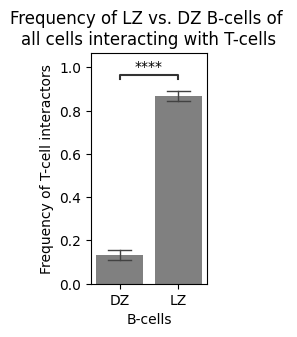

<IPython.core.display.Javascript object>

In [199]:
interaction_df = pd.DataFrame(
    list(bcell_label_freq_df["freq_dz_tcell_interactors"])
    + list(bcell_label_freq_df["freq_lz_tcell_interactors"]),
    columns=["Frequency of T-cell interactors"],
)
interaction_df["B-cells"] = np.array(
    ["DZ"] * len(bcell_label_freq_df) + ["LZ"] * len(bcell_label_freq_df)
)

fig, ax = plt.subplots(figsize=[1.5, 3])
ax = sns.barplot(
    data=interaction_df,
    x="B-cells",
    y="Frequency of T-cell interactors",
    ci="sd",
    capsize=0.4,
    linewidth=0.1,
    # width=0.5,
    errwidth=1,
    dodge=False,
    palette=["gray"],
)
annotator = Annotator(
    ax,
    [("DZ", "LZ")],
    data=interaction_df,
    x="B-cells",
    y="Frequency of T-cell interactors",
)
annotator.configure(test="t-test_welch", text_format="star", loc="inside")
annotator.apply_and_annotate()
ax.set_title("Frequency of LZ vs. DZ B-cells of \nall cells interacting with T-cells")
plt.show()
plt.close()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

DZ vs. LZ: Welch's t-test independent samples, P_val:2.831e-06 t=-7.581e+00


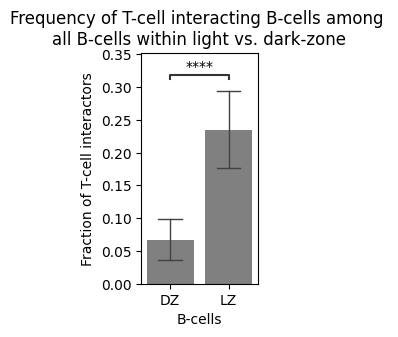

<IPython.core.display.Javascript object>

In [200]:
interaction_df = pd.DataFrame(
    list(bcell_label_freq_df["freq_tcell_interactors_dz"])
    + list(bcell_label_freq_df["freq_tcell_interactors_lz"]),
    columns=["Fraction of T-cell interactors"],
)
interaction_df["B-cells"] = np.array(
    ["DZ"] * len(bcell_label_freq_df) + ["LZ"] * len(bcell_label_freq_df)
)

fig, ax = plt.subplots(figsize=[1.5, 3])
ax = sns.barplot(
    data=interaction_df,
    x="B-cells",
    y="Fraction of T-cell interactors",
    ci="sd",
    capsize=0.4,
    linewidth=0.1,
    # width=0.5,
    errwidth=1,
    dodge=True,
    palette=["gray"],
)
annotator = Annotator(
    ax,
    [("DZ", "LZ")],
    data=interaction_df,
    x="B-cells",
    y="Fraction of T-cell interactors",
)
annotator.configure(test="t-test_welch", text_format="star", loc="inside")
annotator.apply_and_annotate()
ax.set_title(
    "Frequency of T-cell interacting B-cells among \nall B-cells within light vs. dark-zone"
)
plt.show()
plt.close()

----

### Dark-zone prediction probability association with T cell interaction

In [201]:
lz_tcell_infl_bcells = all_bcell_feats.loc[
    (all_bcell_feats.cell_type == "LZ B-cells")
    & (all_bcell_feats.tcell_influence == "T-cell interactors")
]
lz_tcell_noninfl_bcells = all_bcell_feats.loc[
    (all_bcell_feats.cell_type == "LZ B-cells")
    & (all_bcell_feats.tcell_influence == "Non-T-cell interactors")
]
dz_tcell_infl_bcells = all_bcell_feats.loc[
    (all_bcell_feats.cell_type == "DZ B-cells")
    & (all_bcell_feats.tcell_influence == "T-cell interactors")
]
dz_tcell_noninfl_bcells = all_bcell_feats.loc[
    (all_bcell_feats.cell_type == "DZ B-cells")
    & (all_bcell_feats.tcell_influence == "Non-T-cell interactors")
]

<IPython.core.display.Javascript object>

In [202]:
tcell_noninfl_bcells = lz_tcell_noninfl_bcells.append(dz_tcell_noninfl_bcells)
tcell_infl_bcells = lz_tcell_infl_bcells.append(dz_tcell_infl_bcells)

noninfl_bcell_nuc_feats = bcell_nuc_feats.loc[tcell_noninfl_bcells.index]
noninfl_bcell_labels = bcell_labels.loc[tcell_noninfl_bcells.index]

<IPython.core.display.Javascript object>

To train the classifier we will as before subsample the data set such that we have an equal number of samples of dark- and light zone B cells outside of the influence of the T cells.
Note that we set this number to just 80% of the largest possible number as we want to keep all remaining samples additionally for testing. The reason for that is that the classifier will certainly give rise to higher probabilities for the training set samples and thus to compare the prediction probabilities between the two zones of germinal centers and with respect to the T cell interaction, we need to ensure that we only consider samples hold-out during training for all categories.

In [203]:
np.random.seed(seed)
min_noninfl_labels = min(len(lz_tcell_noninfl_bcells), len(dz_tcell_noninfl_bcells))
n_train_noninfl_train_samples = int(0.8 * min_noninfl_labels)


train_noninfl_bcells_idc = list(
    np.random.choice(
        list(lz_tcell_noninfl_bcells.index),
        size=n_train_noninfl_train_samples,
        replace=False,
    )
)
train_noninfl_bcells_idc += list(
    np.random.choice(
        list(dz_tcell_noninfl_bcells.index),
        size=n_train_noninfl_train_samples,
        replace=False,
    )
)

train_noninfl_bcells = all_bcell_feats.loc[train_noninfl_bcells_idc]
test_noninfl_bcells = all_bcell_feats.loc[
    ~all_bcell_feats.index.isin(train_noninfl_bcells_idc)
]
test_non_and_infl_bcells = test_noninfl_bcells.append(
    all_bcell_feats.loc[tcell_infl_bcells.index]
)

<IPython.core.display.Javascript object>

Let us quickly assess the distribution of the different labels in the training and test set.

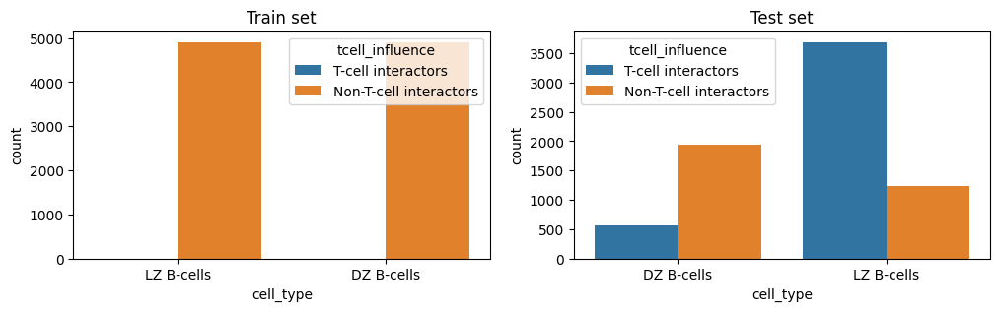

<IPython.core.display.Javascript object>

In [204]:
fig, ax = plt.subplots(figsize=[12, 3], ncols=2)
ax = ax.flatten()
ax[0] = sns.countplot(
    data=train_noninfl_bcells,
    x="cell_type",
    hue="tcell_influence",
    ax=ax[0],
    hue_order=["T-cell interactors", "Non-T-cell interactors"],
)
ax[0].set_title("Train set")
ax[1] = sns.countplot(
    data=test_noninfl_bcells,
    x="cell_type",
    hue="tcell_influence",
    ax=ax[1],
    hue_order=["T-cell interactors", "Non-T-cell interactors"],
)
ax[1].set_title("Test set")
plt.show()

In [205]:
rfc = RandomForestClassifier(n_estimators=100, n_jobs=8, random_state=seed)

<IPython.core.display.Javascript object>

In [206]:
fitted_noninfl_bcell_rfc = rfc.fit(
    X=bcell_nuc_feats.loc[train_noninfl_bcells.index],
    y=bcell_labels.loc[train_noninfl_bcells.index],
)

<IPython.core.display.Javascript object>

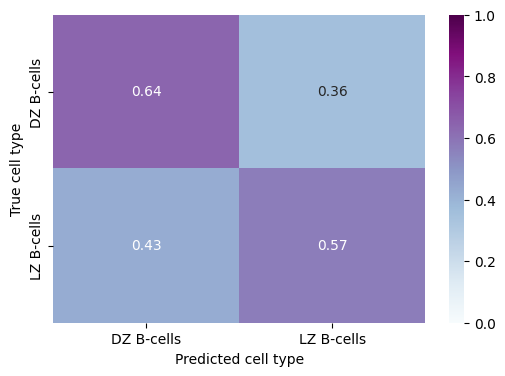

<IPython.core.display.Javascript object>

In [207]:
test_non_and_infl_predictions = fitted_noninfl_bcell_rfc.predict(
    X=bcell_nuc_feats.loc[test_non_and_infl_bcells.index]
)
test_non_and_infl_labels = bcell_labels.loc[test_non_and_infl_bcells.index]

noninfl_bcell_rfc_conf_mtx = metrics.confusion_matrix(
    test_non_and_infl_labels,
    test_non_and_infl_predictions,
    normalize="true",
    labels=list(fitted_noninfl_bcell_rfc.classes_),
)
noninfl_bcell_rfc_conf_mtx = pd.DataFrame(
    noninfl_bcell_rfc_conf_mtx,
    index=list(fitted_noninfl_bcell_rfc.classes_),
    columns=list(fitted_noninfl_bcell_rfc.classes_),
)
fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.heatmap(
    noninfl_bcell_rfc_conf_mtx, annot=True, cmap="BuPu", ax=ax, vmin=0, vmax=1
)
ax.set_xlabel("Predicted cell type")
ax.set_ylabel("True cell type")
plt.show()
plt.close()

The confusion matrix below shows that the class separability is comparable to the one we have seen before when not excluding any B cells interacting with T cells.

After again showing that there is a significant difference between the dark-zone and light-zone B cells, we will now use the predicted class probability of a cell being in the dark-zone as a proxy of the dark-zone B cell like phenotype of all cells in the hold out test set.

In [208]:
selected_features = list(bcell_nuc_feats.columns)
test_non_and_infl_bcells = add_predictions(
    model=fitted_noninfl_bcell_rfc,
    data=gc_nuc_features.loc[test_non_and_infl_bcells.index],
    selected_features=selected_features,
    label_col="cell_type",
    pos_label="DZ B-cells",
)

<IPython.core.display.Javascript object>

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

DZ B-cells_T-cell interactors vs. DZ B-cells_Non-T-cell interactors: Welch's t-test independent samples, P_val:1.522e-04 t=-3.793e+00
LZ B-cells_T-cell interactors vs. LZ B-cells_Non-T-cell interactors: Welch's t-test independent samples, P_val:1.654e-06 t=4.809e+00


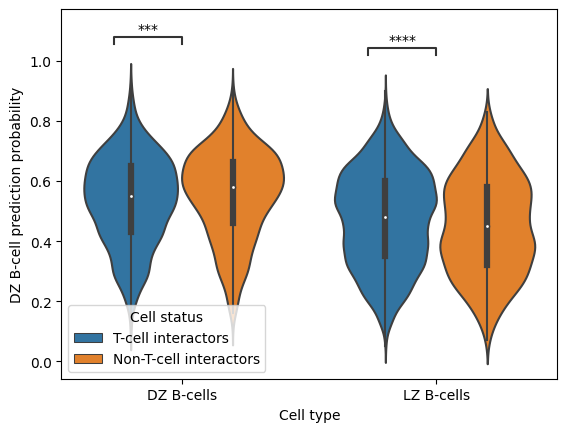

<IPython.core.display.Javascript object>

In [209]:
ax = sns.violinplot(
    data=test_non_and_infl_bcells,
    x="cell_type",
    y="cell_type_prediction_prob",
    hue="tcell_influence",
    hue_order=["T-cell interactors", "Non-T-cell interactors"],
)
annotator = Annotator(
    ax,
    [
        (
            ("DZ B-cells", "T-cell interactors"),
            ("DZ B-cells", "Non-T-cell interactors"),
        ),
        (
            ("LZ B-cells", "T-cell interactors"),
            ("LZ B-cells", "Non-T-cell interactors"),
        ),
    ],
    data=test_non_and_infl_bcells,
    x="cell_type",
    y="cell_type_prediction_prob",
    hue="tcell_influence",
    plot="violinplot",
)
ax.legend(title="T-cell interaction")
annotator.configure(test="t-test_welch", text_format="star", loc="inside")
annotator.apply_and_annotate()
ax.set_ylabel("DZ B-cell prediction probability")
ax.set_xlabel("Cell type")
ax.legend(title="Cell status", loc="lower left")
plt.show()
plt.close()

The above plot indicates that dark-zone B cells interacting with T cells and those not interacting with T cells are not associated with significant differences with respect to their similarity to dark-zone B cells not interacting with T cells that formed the training set. This suggests that the observed changes between dark-zone and light zone B cells not interacting with B cells do not align with the differences between dark-zone B cells non- resp. interacting with T cells.

We will now rerun the analysis but this also use a couple B cells interacting with T cells in the training set. We will again take an equal amount of those from the light and dark-zone to ensure that we do not bias our solution implicitely to simply display the previously assessed differences in the mechanical states of the dark and light-zone B cells.

In [210]:
np.random.seed(seed)
train_frac = 0.8
min_noninfl_labels = min(len(lz_tcell_noninfl_bcells), len(dz_tcell_noninfl_bcells))
min_infl_labels = min(len(lz_tcell_infl_bcells), len(dz_tcell_infl_bcells))
min_noninfl_labels = min_infl_labels = min(min_noninfl_labels, min_infl_labels)
n_train_noninfl_samples = int(train_frac * min_noninfl_labels)
n_train_infl_samples = int(train_frac * min_infl_labels)


train_bcells_idc = list(
    np.random.choice(
        list(lz_tcell_noninfl_bcells.index), size=n_train_noninfl_samples, replace=False
    )
)
train_bcells_idc += list(
    np.random.choice(
        list(dz_tcell_noninfl_bcells.index), size=n_train_noninfl_samples, replace=False
    )
)
train_bcells_idc += list(
    np.random.choice(
        list(lz_tcell_infl_bcells.index), size=n_train_infl_samples, replace=False
    )
)
train_bcells_idc += list(
    np.random.choice(
        list(dz_tcell_infl_bcells.index), size=n_train_infl_samples, replace=False
    )
)

train_bcells = all_bcell_feats.loc[train_bcells_idc]
test_bcells = all_bcell_feats.loc[~all_bcell_feats.index.isin(train_bcells_idc)]

<IPython.core.display.Javascript object>

Let us quickly assess the distribution of the different labels in the training and test set.

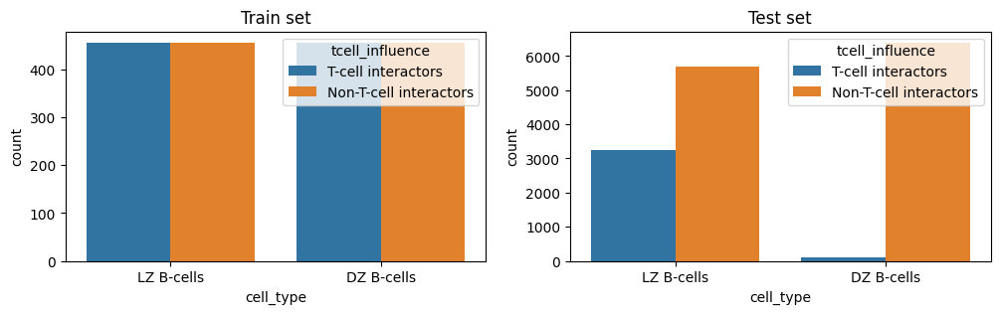

<IPython.core.display.Javascript object>

In [211]:
fig, ax = plt.subplots(figsize=[12, 3], ncols=2)
ax = ax.flatten()
ax[0] = sns.countplot(
    data=train_bcells,
    x="cell_type",
    hue="tcell_influence",
    ax=ax[0],
    hue_order=["T-cell interactors", "Non-T-cell interactors"],
)
ax[0].set_title("Train set")
ax[1] = sns.countplot(
    data=test_bcells,
    x="cell_type",
    hue="tcell_influence",
    ax=ax[1],
    hue_order=["T-cell interactors", "Non-T-cell interactors"],
)
ax[1].set_title("Test set")
plt.show()

In [212]:
len(train_bcells)

1824

<IPython.core.display.Javascript object>

In [213]:
rfc = RandomForestClassifier(n_estimators=100, n_jobs=8, random_state=seed)
fitted_bcell_rfc = rfc.fit(
    X=bcell_nuc_feats.loc[train_bcells.index],
    y=bcell_labels.loc[train_bcells.index],
)

<IPython.core.display.Javascript object>

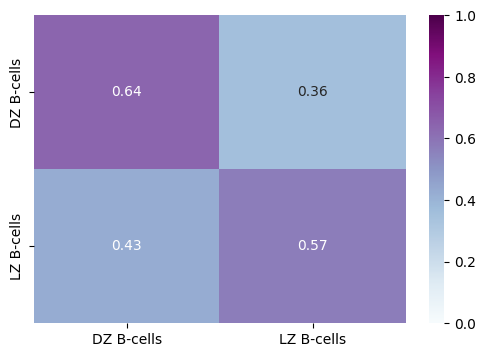

<IPython.core.display.Javascript object>

In [214]:
test_predictions = fitted_bcell_rfc.predict(X=bcell_nuc_feats.loc[test_bcells.index])
test_labels = bcell_labels.loc[test_bcells.index]

bcell_rfc_conf_mtx = metrics.confusion_matrix(
    test_labels,
    test_predictions,
    normalize="true",
    labels=list(fitted_bcell_rfc.classes_),
)
bcell_rfc_conf_mtx = pd.DataFrame(
    bcell_rfc_conf_mtx,
    index=list(fitted_bcell_rfc.classes_),
    columns=list(fitted_bcell_rfc.classes_),
)
fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.heatmap(bcell_rfc_conf_mtx, annot=True, cmap="BuPu", ax=ax, vmin=0, vmax=1)

The confusion matrix below shows that the class separability is comparable to the one we have seen before when not excluding any B cells interacting with T cells.

After again showing that there is a significant difference between the dark-zone and light-zone B cells, we will now use the predicted class probability of a cell being in the dark-zone as a proxy of the dark-zone B cell like phenotype of all cells in the hold out test set.

In [215]:
selected_features = list(bcell_nuc_feats.columns)
test_bcells = add_predictions(
    model=fitted_bcell_rfc,
    data=gc_nuc_features.loc[test_bcells.index],
    selected_features=selected_features,
    label_col="cell_type",
    pos_label="DZ B-cells",
)
test_bcells["DZ B-cell prediction probability"] = test_bcells.loc[
    :, "cell_type_prediction_prob"
]

<IPython.core.display.Javascript object>

In [216]:
test_bcells.groupby(["cell_type", "tcell_influence"]).mean().cell_type_prediction_prob

cell_type   tcell_influence             
DZ B-cells  Non-T-cell interactors          0.533371
            T-cell interactors              0.527807
            potential T-cell interactors    0.513871
LZ B-cells  Non-T-cell interactors          0.459097
            T-cell interactors              0.477643
            potential T-cell interactors    0.454709
Name: cell_type_prediction_prob, dtype: float64

<IPython.core.display.Javascript object>

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

DZ B-cells_T-cell interactors vs. DZ B-cells_Non-T-cell interactors: Welch's t-test independent samples, P_val:1.522e-04 t=-3.793e+00
LZ B-cells_T-cell interactors vs. LZ B-cells_Non-T-cell interactors: Welch's t-test independent samples, P_val:1.654e-06 t=4.809e+00


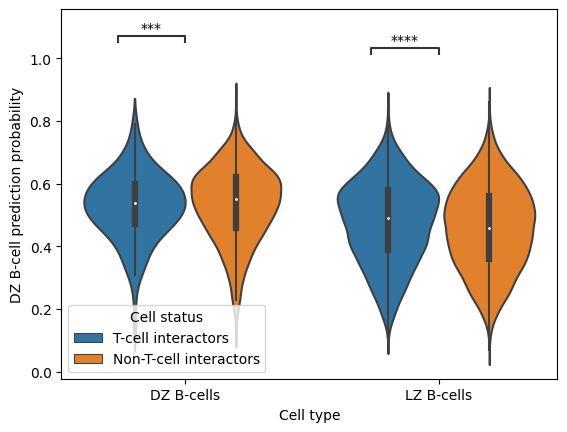

<IPython.core.display.Javascript object>

In [217]:
ax = sns.violinplot(
    data=test_bcells,
    x="cell_type",
    y="DZ B-cell prediction probability",
    order=["DZ B-cells", "LZ B-cells"],
    hue="tcell_influence",
    hue_order=["T-cell interactors", "Non-T-cell interactors"],
)
annotator = Annotator(
    ax,
    [
        (
            ("DZ B-cells", "T-cell interactors"),
            ("DZ B-cells", "Non-T-cell interactors"),
        ),
        (
            ("LZ B-cells", "T-cell interactors"),
            ("LZ B-cells", "Non-T-cell interactors"),
        ),
    ],
    data=test_non_and_infl_bcells,
    x="cell_type",
    y="cell_type_prediction_prob",
    hue="tcell_influence",
    plot="violinplot",
)
annotator.configure(test="t-test_welch", text_format="star", loc="inside")
annotator.apply_and_annotate()
ax.set_xlabel("Cell type")
ax.legend(title="Cell status", loc="lower left")
plt.show()
plt.close()

----
----

### 3.3. B cells at the boundary of the dark and light zone.

The previous analysis showed that there is the chromatin organization and nuclear morphology is not indicative of whether a T cell is seen in close proximity of it given its location in either the dark or light zone of the germinal center. However, we still observe a separation of these two zones and general differences between the DZ and LZ B-cells. Hence, we hypothesize that the separation of the two zones which are linked to different levels of T-cell infiltration is controlled by the cells at the boundary of the two zones, i.e. the cells at the boundary of the dark and light zone feature specific cell states that are responsible for the separation of those two phases. Thereby, we expect that in particular the DZ B-cells also represent some function that keeps the majority of the T cells from infiltrating the dark zone. To test this hypothesis we assess the differences in the chromatin organization and nuclear morphology of the DZ and LZ B-cells in the context of their distance to the boundary of the two zones.

#### Obtain nuclear distances to the boundary of the dark & light zone

To this end, we first need to compute the distance of each B-cell in the germinal centers to the boundary of the corresponding dark and light zone. We obtain such measures by the following procedure:

For each DZ B-cells we identify the k (k=2% of the total number of cells in the germinal center) LZ B-cells for each germinal center that are closest in terms of the euclidean distance of the nuclear centroids. We then obtain the average distance as proxy of that respective cell to the boundary of the dark and light zone in the corresponding germinal center. We then do the same in reversed fashion for the LZ B-cells. The idea is that DZ respectively LZ B-cells close to the border have a low average distance to their closest corresponding counterparts in the respective other zone of the germinal centers.

As an alternative we also obtain a proxy for the distance to the border by assessing the frequency of DZ B-cells for each cell among the 50 nearest neighbors with respect to the euclidean distance of the centroids. For cells at the border we expect the ratio to be roughly 50% irrespective of whether we consider a LZ or DZ B-cell. The more the actual distances differs from that ratio, the farer away from the boundary a B-cell is.

We now compute those measures and plot the results for the 10 germinal centers.

In [218]:
dlz_border_distance_df = get_distances_to_dz_lz_border(
    gc_nuc_features, spatial_cord, alpha=0.02
)

<IPython.core.display.Javascript object>

#### Visualization of the distance measures

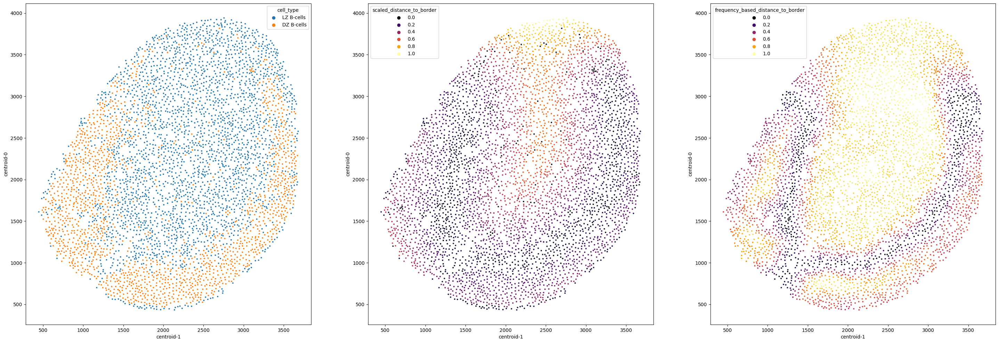

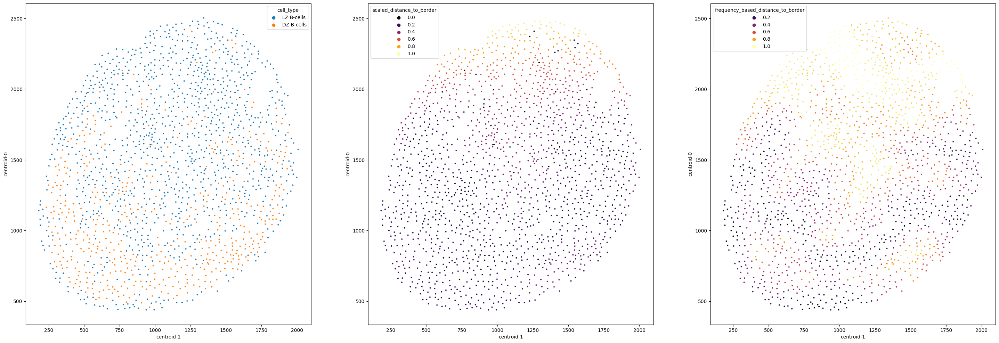

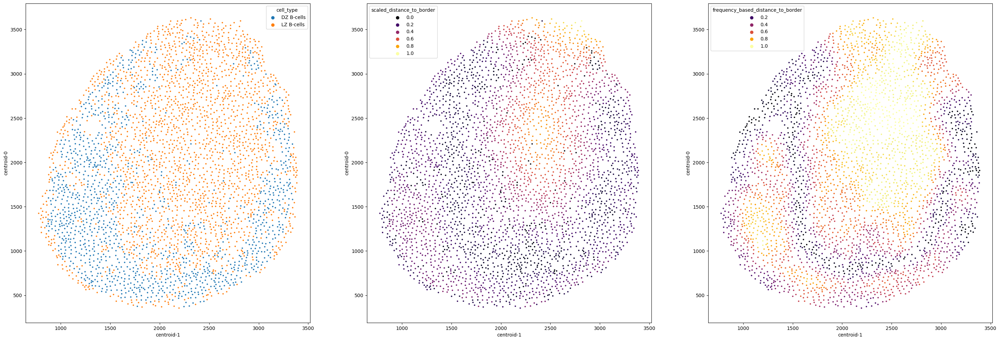

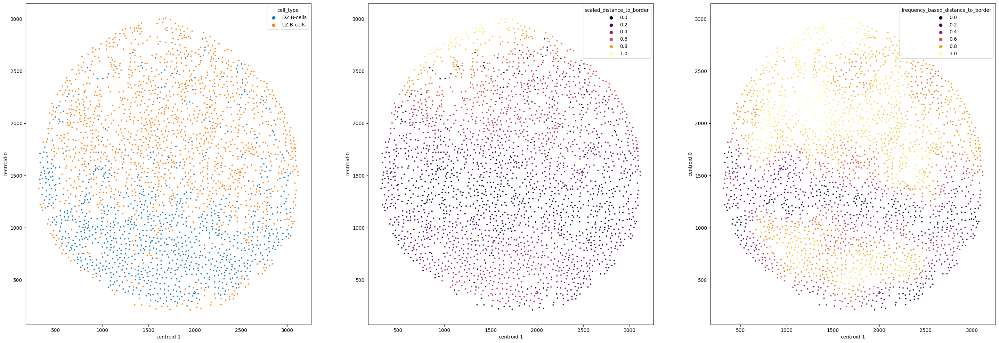

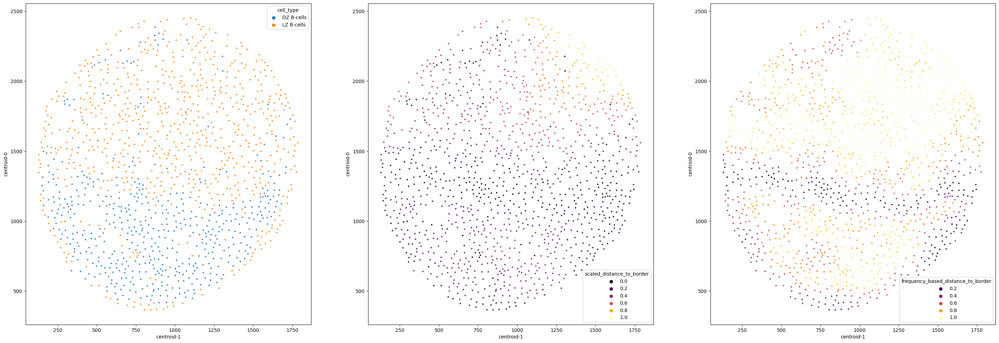

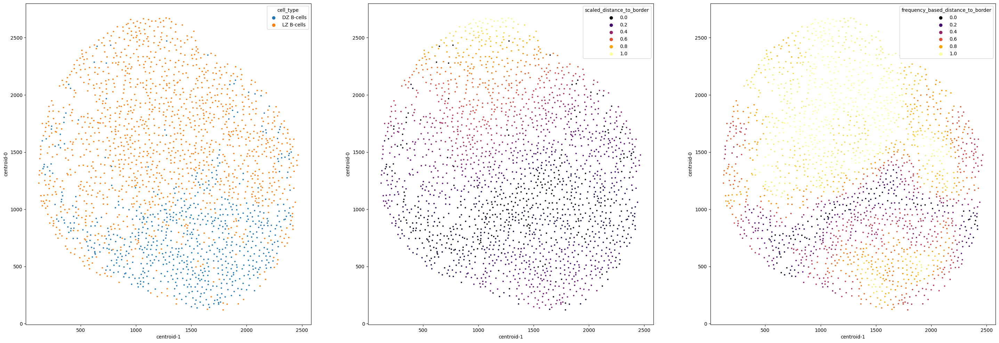

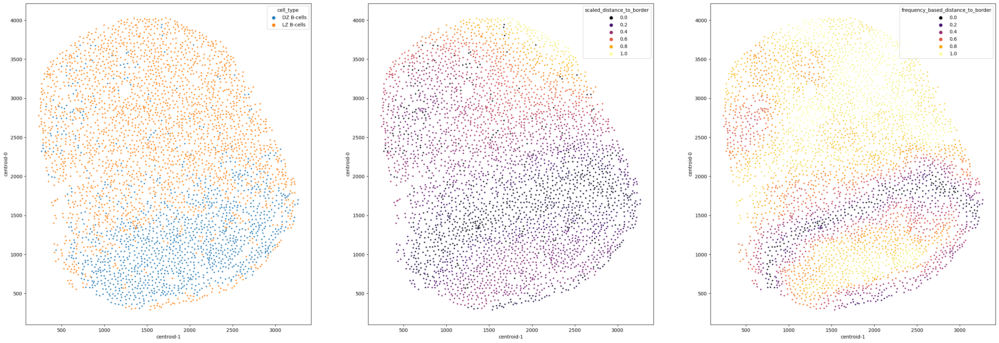

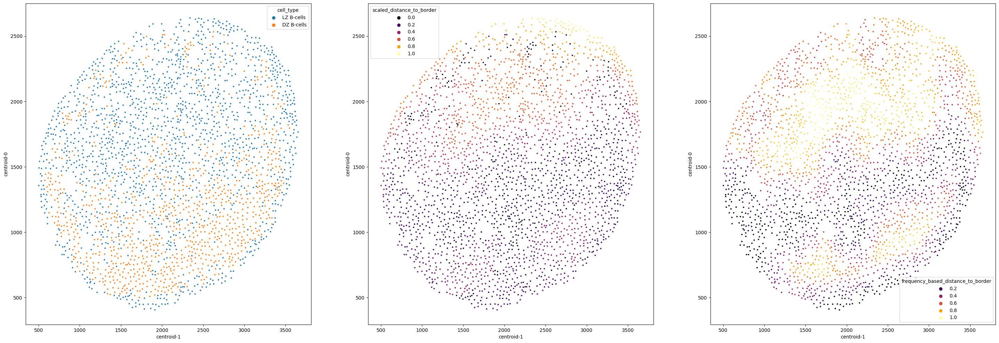

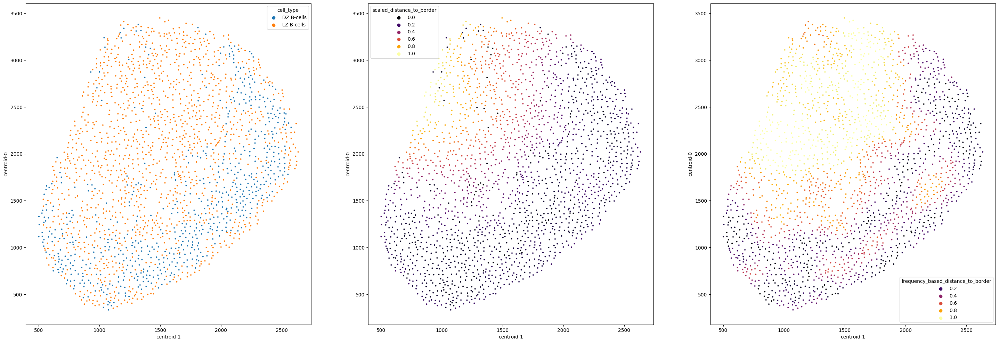

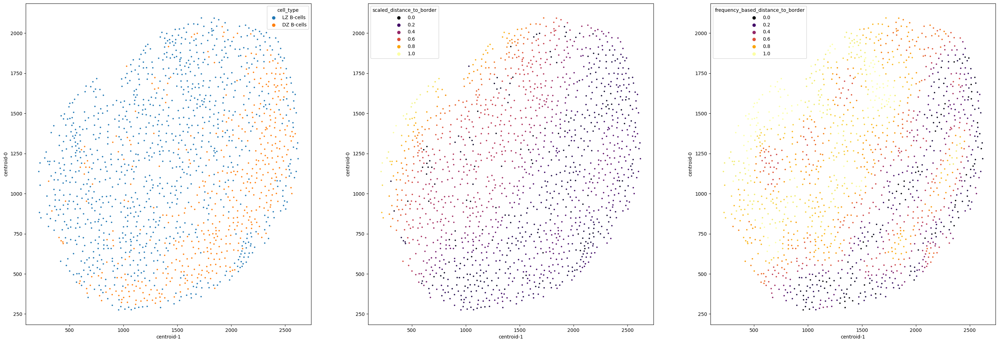

<IPython.core.display.Javascript object>

In [219]:
plt.style.use("default")

for image in np.unique(dlz_border_distance_df.image):
    fig, ax = plt.subplots(figsize=[36, 12], ncols=3)
    ax = ax.flatten()
    ax[0] = sns.scatterplot(
        data=dlz_border_distance_df.loc[dlz_border_distance_df.image == image],
        x="centroid-1",
        y="centroid-0",
        hue="cell_type",
        ax=ax[0],
        s=10,
    )
    ax[1] = sns.scatterplot(
        data=dlz_border_distance_df.loc[dlz_border_distance_df.image == image],
        x="centroid-1",
        y="centroid-0",
        hue="scaled_distance_to_border",
        ax=ax[1],
        s=10,
        palette="inferno",
    )
    ax[2] = sns.scatterplot(
        data=dlz_border_distance_df.loc[dlz_border_distance_df.image == image],
        x="centroid-1",
        y="centroid-0",
        hue="frequency_based_distance_to_border",
        ax=ax[2],
        s=10,
        palette="inferno",
    )

Based on the plots we decide to use the frequency-based measure as a proxy of the distance of each B-cell in the germinal center to the DZ/LZ border.

---

#### Discrimination of B-cells in the proximity of the LZ/DZ border

We next set a threshold for the distance to obtain two types of B-cells those within the proximity of the border and those that are distant from the border. In particular we determine cells whose frequency-based distance measure is greater than 0.4 to be distant from the border. The plots below show the resulting grouping of cells for the individual germinal centers.

In [220]:
threshold = 0.4
dlz_border_distance_df["border_proximity"] = np.array(
    (
        dlz_border_distance_df.loc[:, "frequency_based_distance_to_border"] < threshold
    ).map({True: "close", False: "distant"})
)

<IPython.core.display.Javascript object>

1


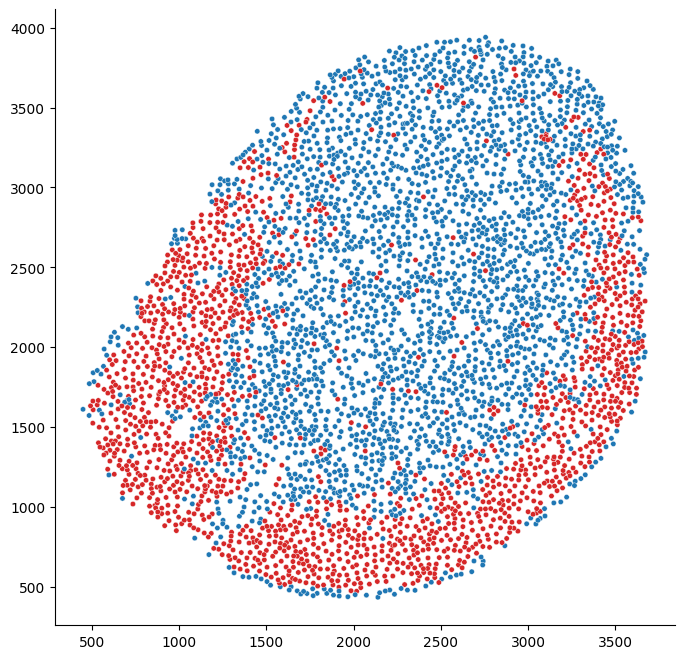

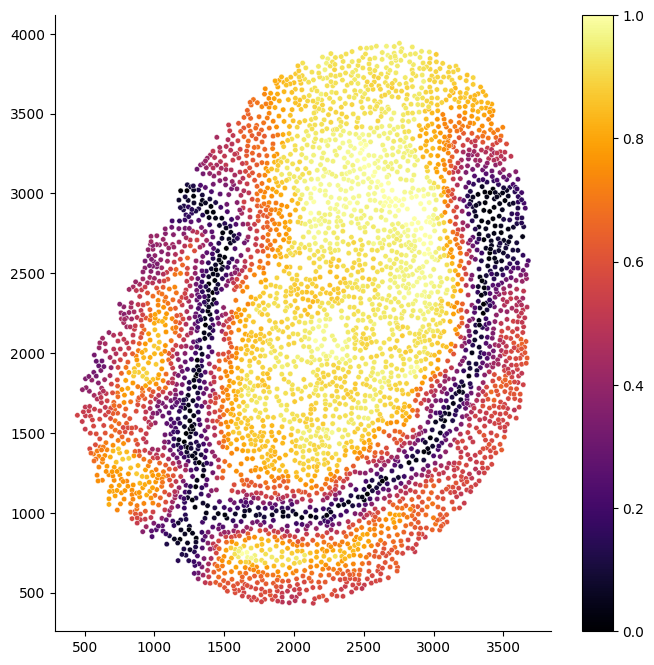

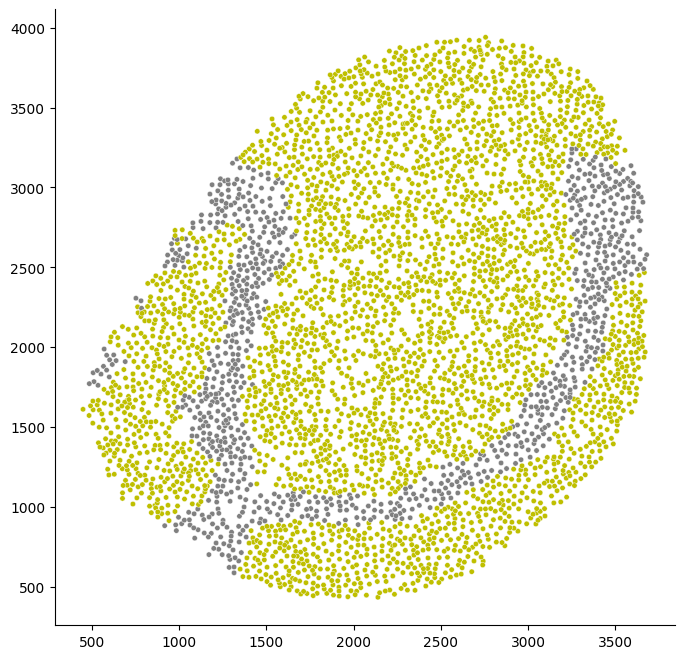

2


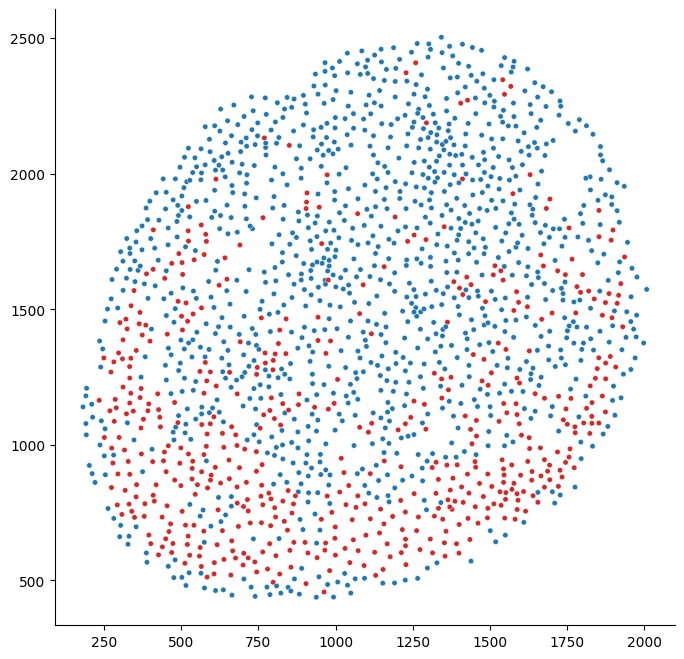

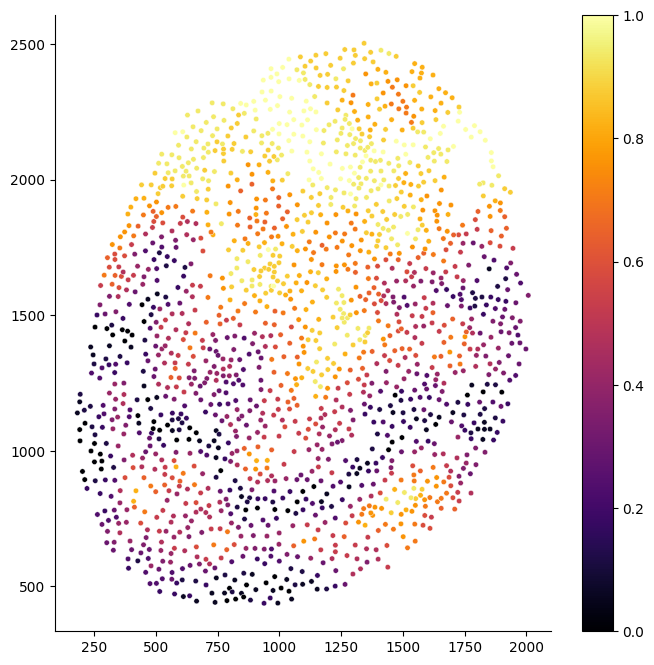

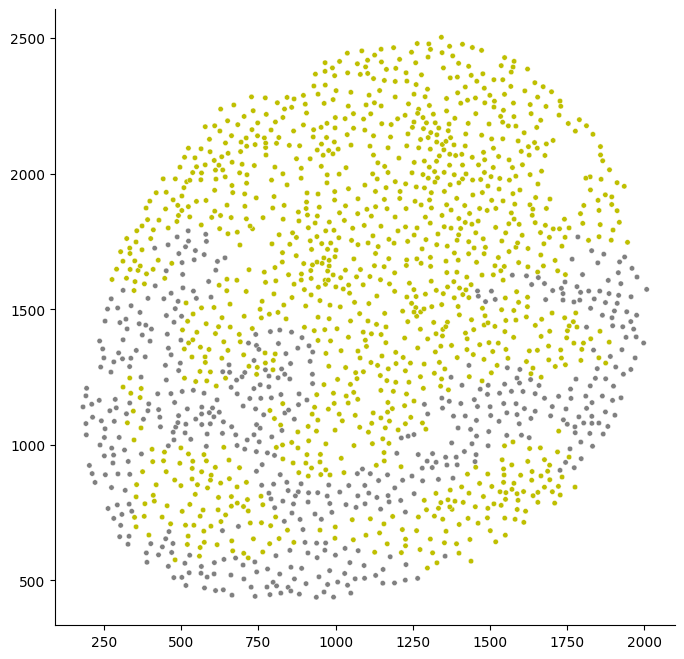

3


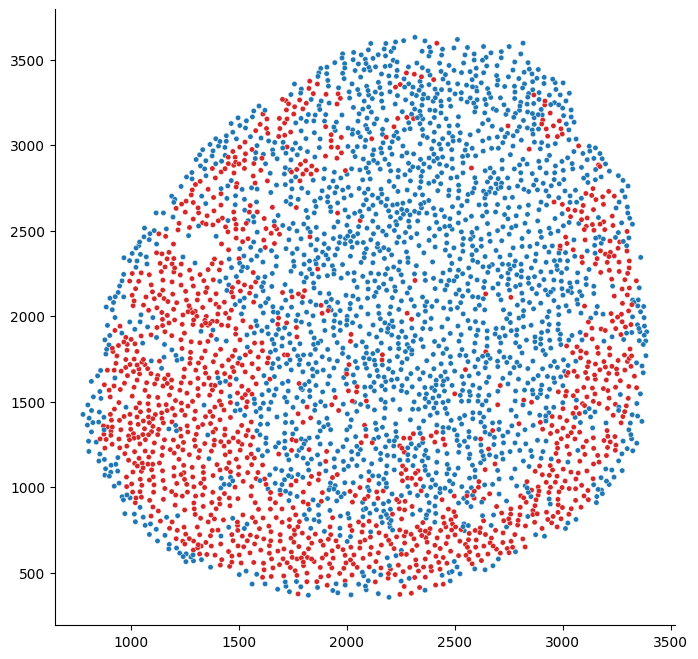

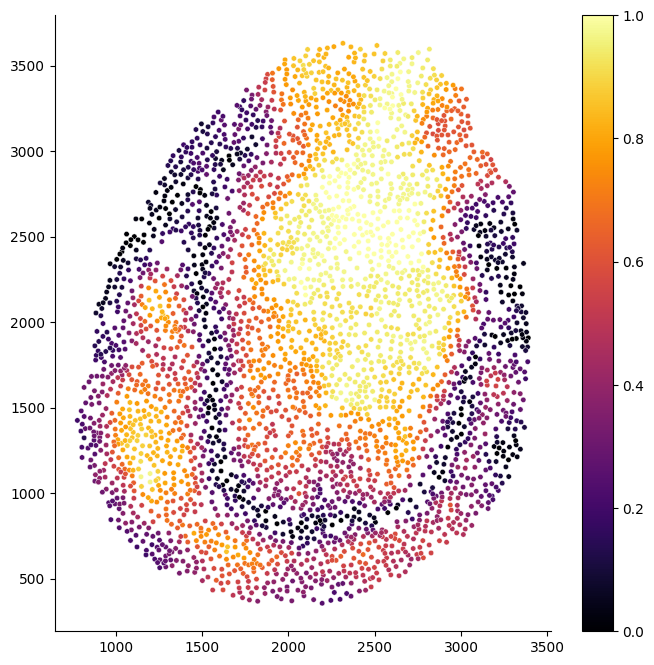

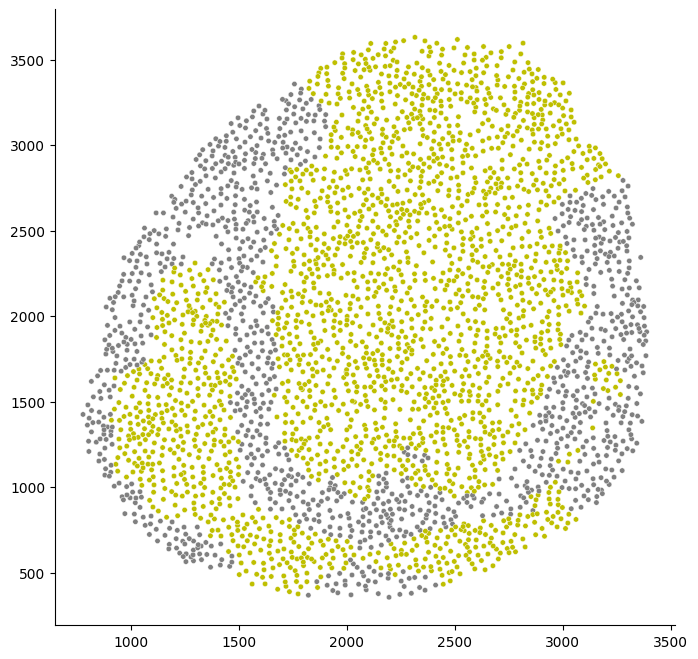

4


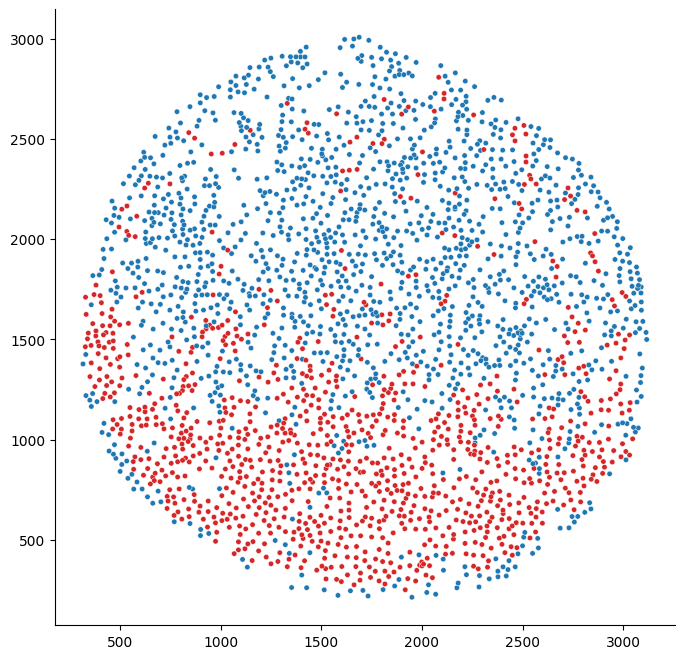

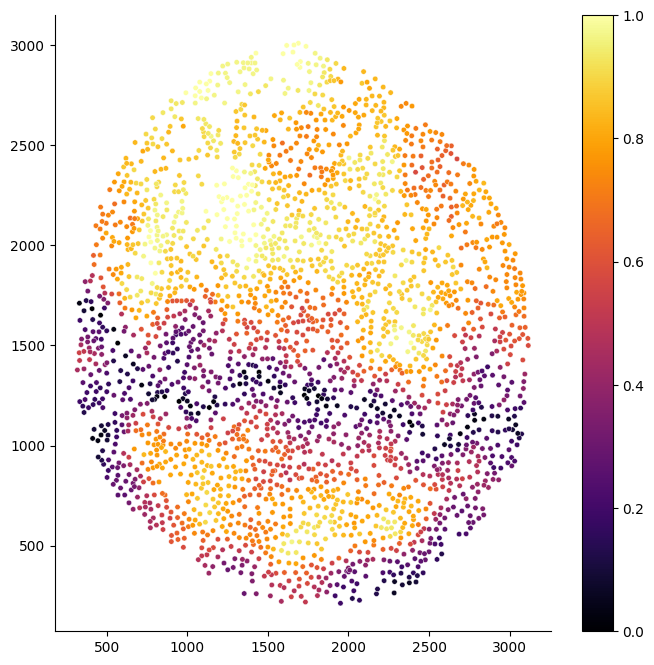

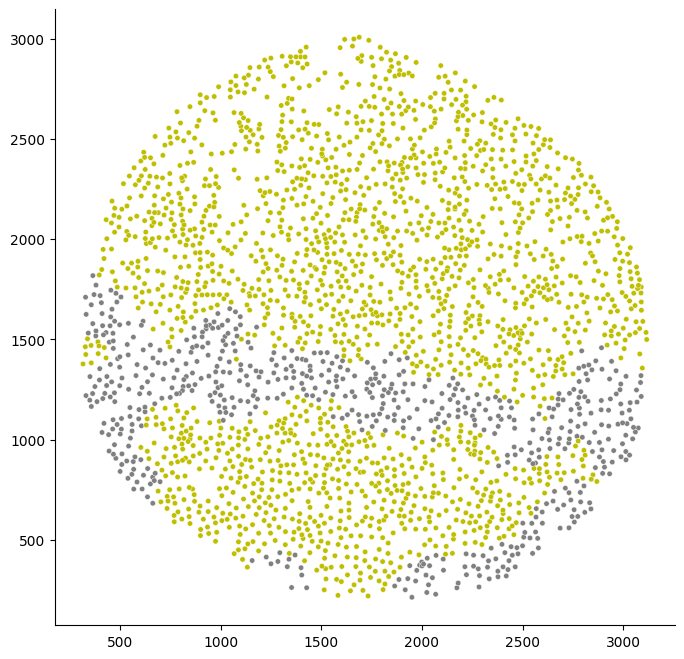

5


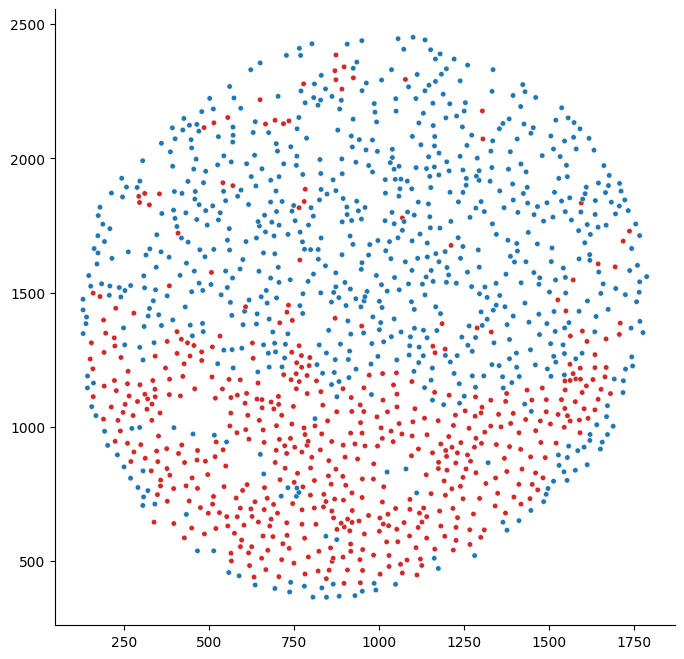

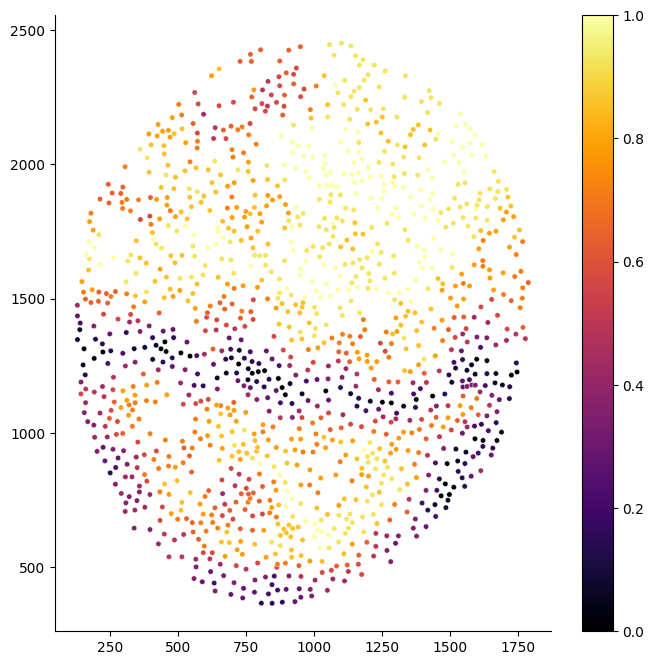

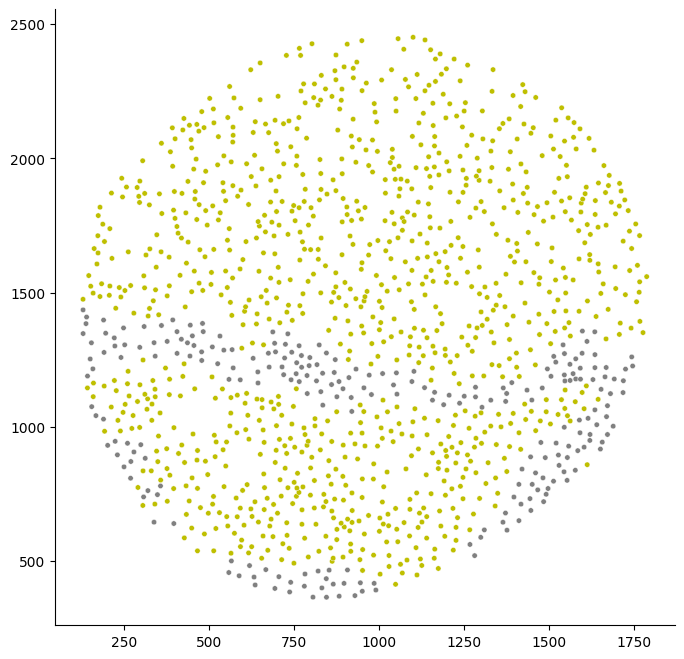

6


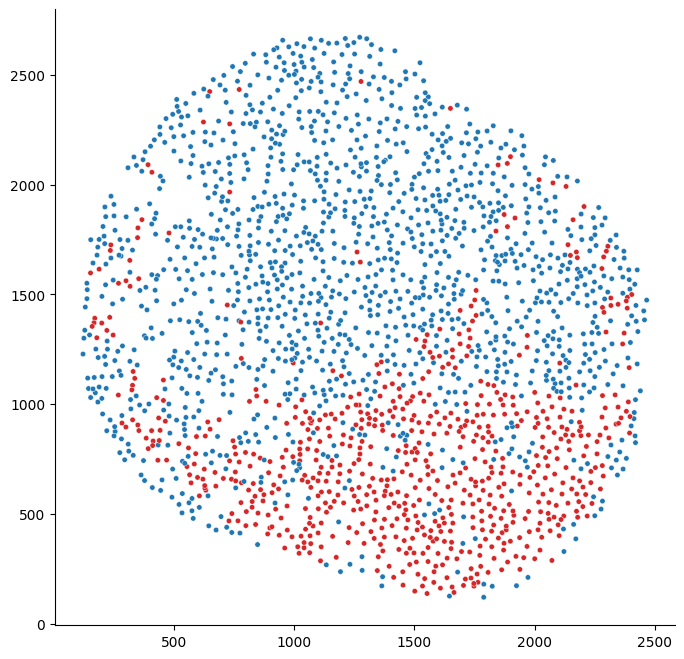

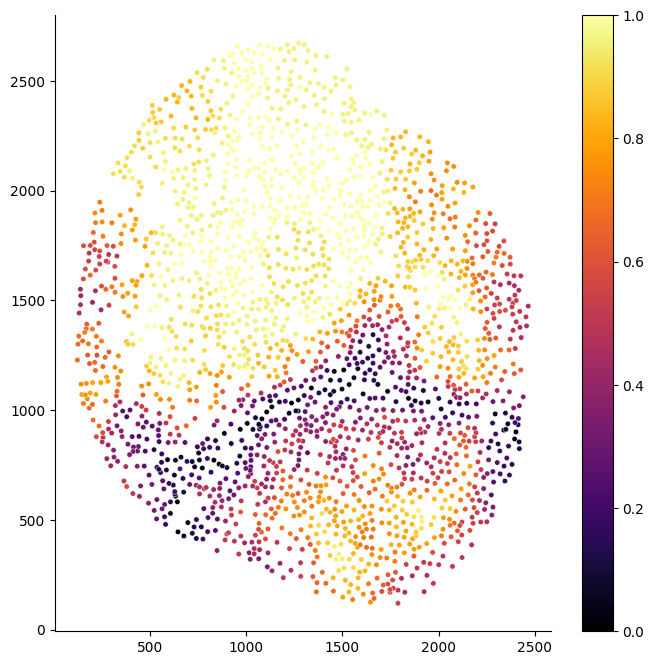

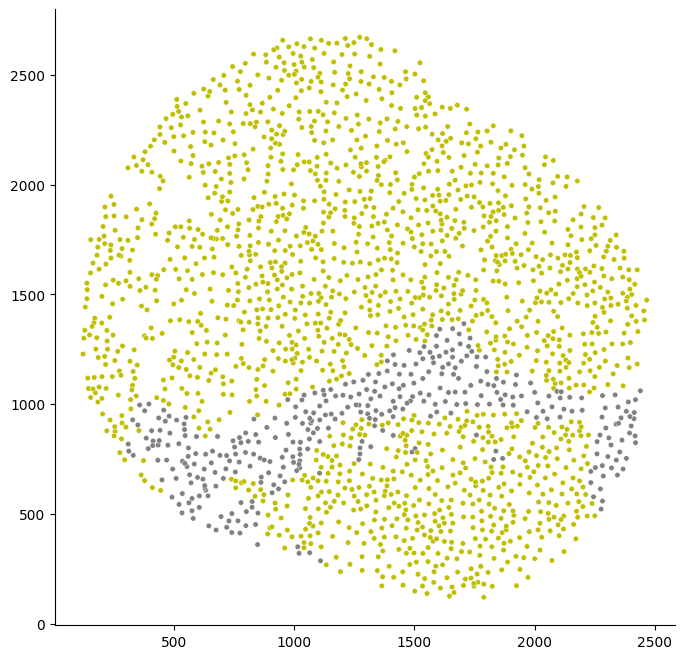

7


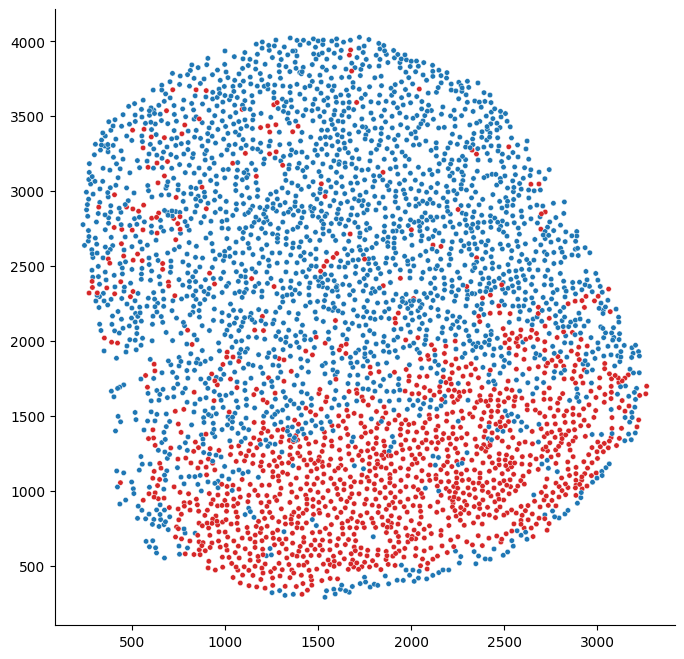

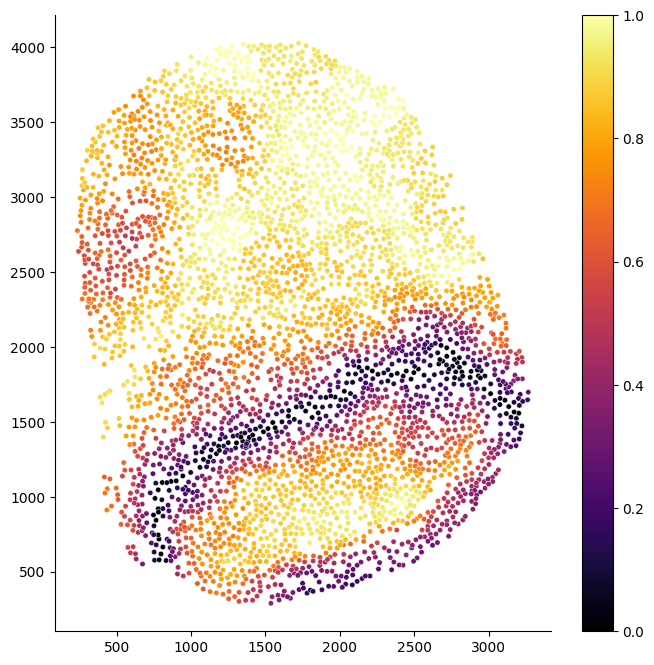

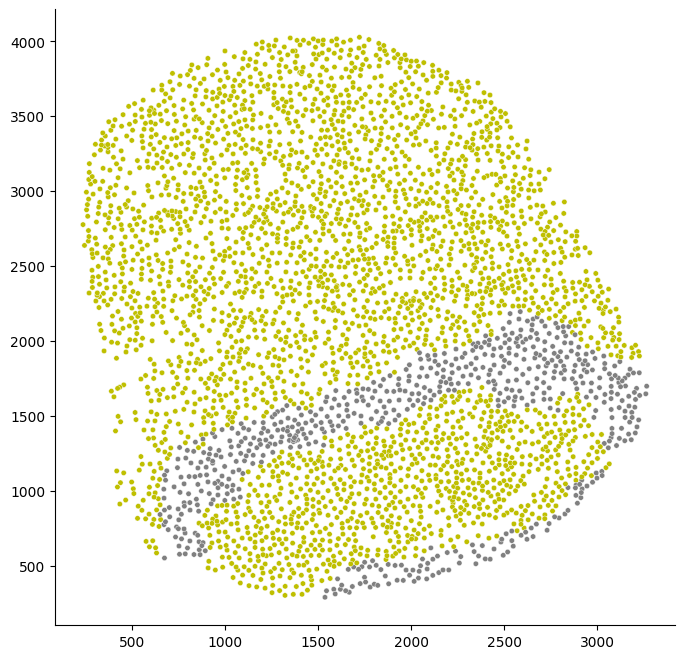

8


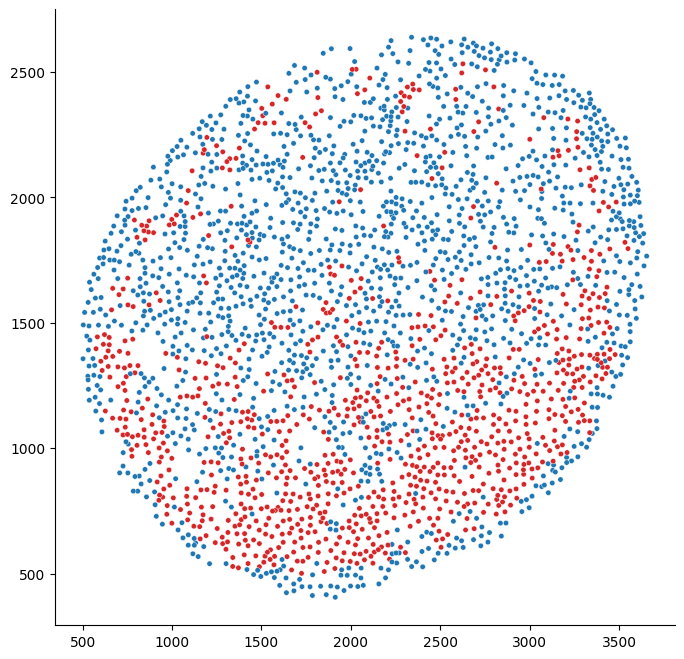

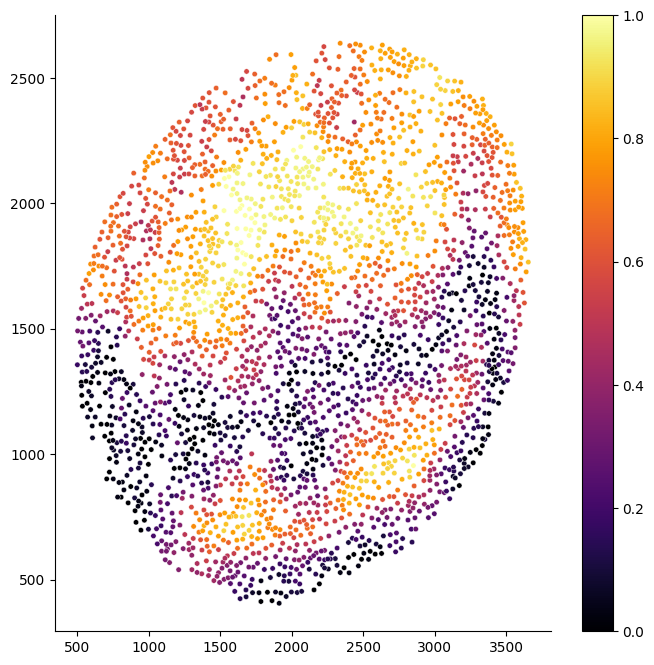

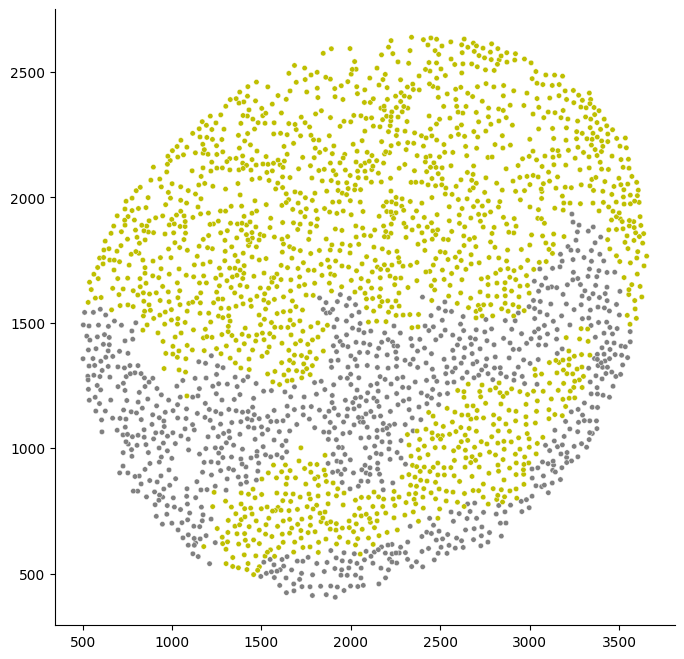

10


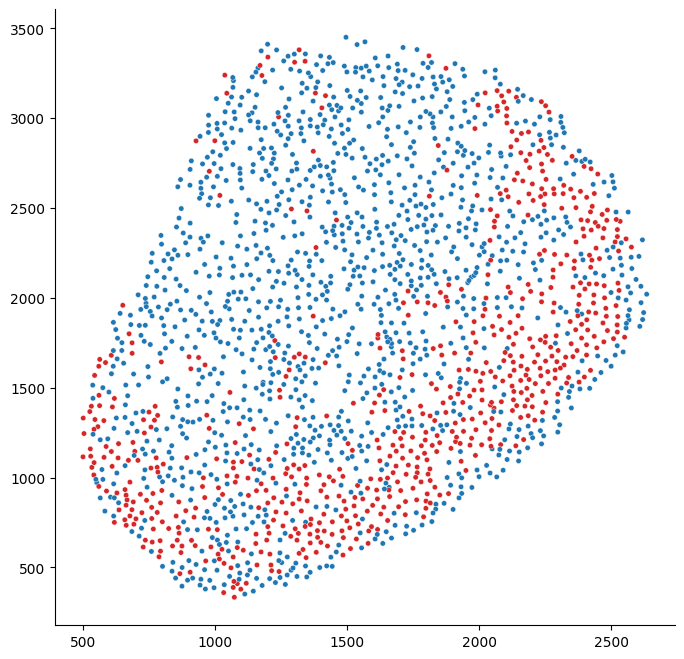

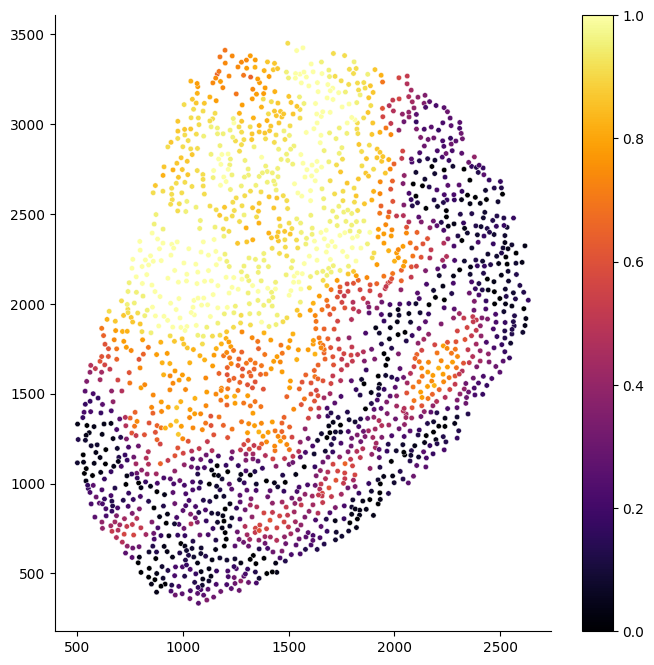

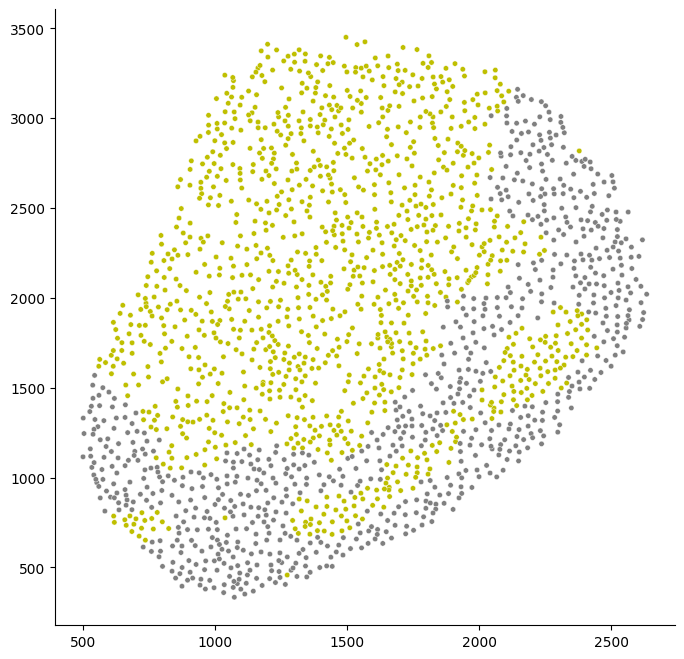

14


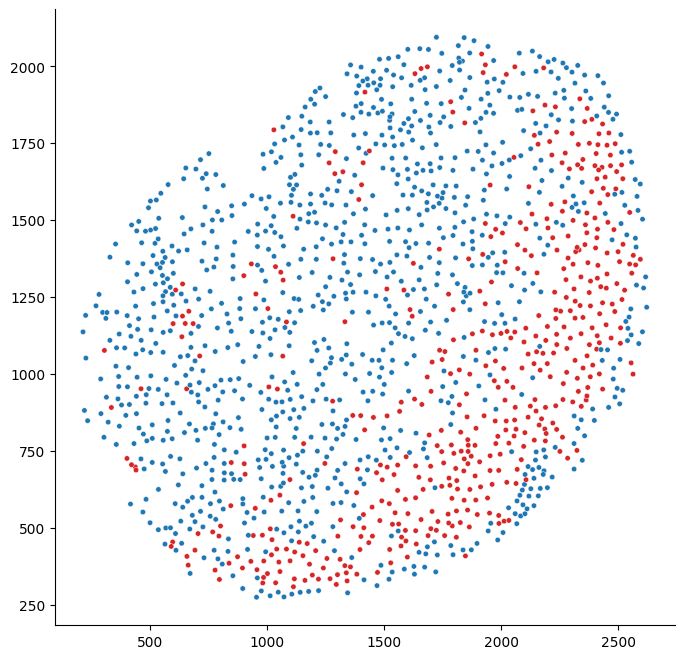

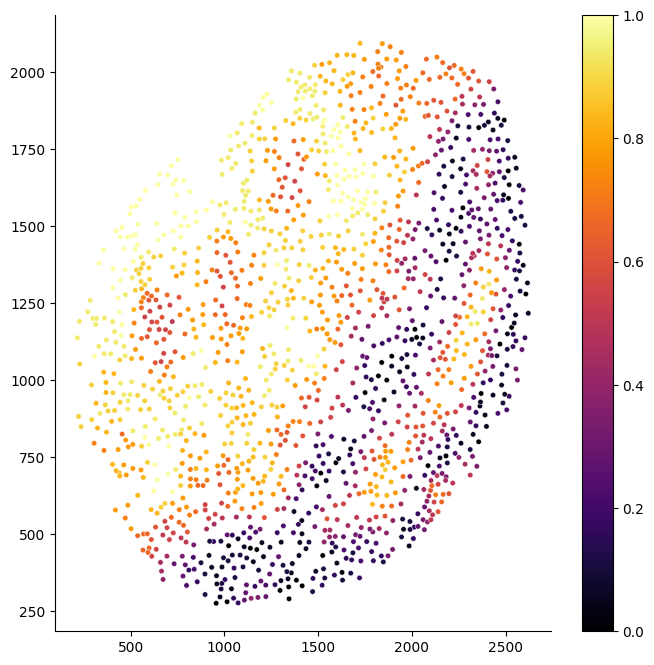

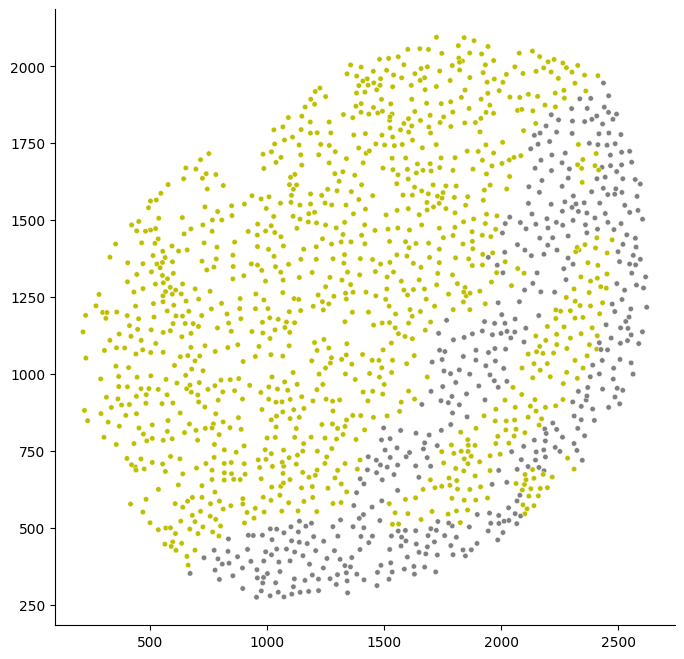

<IPython.core.display.Javascript object>

In [221]:
for image in np.unique(dlz_border_distance_df.image):
    print(image)
    fig, ax = plt.subplots(figsize=[8, 8])
    ax = sns.scatterplot(
        data=dlz_border_distance_df.loc[dlz_border_distance_df.image == image],
        x="centroid-1",
        y="centroid-0",
        hue="cell_type",
        ax=ax,
        s=15,
        hue_order=["LZ B-cells", "DZ B-cells"],
        palette=["tab:blue", "tab:red"],
        legend=False,
    )
    ax.set_xlabel("")
    ax.set_ylabel("")
    sns.despine()
    plt.show()
    plt.close()

    fig, ax = plt.subplots(figsize=[8, 8])
    ax = sns.scatterplot(
        data=dlz_border_distance_df.loc[dlz_border_distance_df.image == image],
        x="centroid-1",
        y="centroid-0",
        hue="frequency_based_distance_to_border",
        ax=ax,
        s=15,
        palette="inferno",
        legend=False,
    )
    norm = plt.Normalize(0, 1)
    sm = plt.cm.ScalarMappable(cmap="inferno", norm=norm)
    sm.set_array([])
    ax.figure.colorbar(sm)
    ax.set_xlabel("")
    ax.set_ylabel("")
    sns.despine()
    plt.show()
    plt.close()

    fig, ax = plt.subplots(figsize=[8, 8])
    ax = sns.scatterplot(
        data=dlz_border_distance_df.loc[dlz_border_distance_df.image == image],
        x="centroid-1",
        y="centroid-0",
        hue="border_proximity",
        ax=ax,
        s=15,
        palette=["gray", "y"],
        hue_order=["close", "distant"],
        legend=False,
    )
    ax.set_xlabel("")
    ax.set_ylabel("")
    sns.despine()
    plt.show()
    plt.close()

---

#### Discriminability of DZ B-cells close vs. distant to the boundary

We next assess if the DZ B-cells that are close to the boundary of the DZ/LZ boundary show different chromatin organization and nuclear morphology compared to the DZ B-cells that are distant from the boundary. To this end, we will obtain a random subset of all DZ B-cells from the germinal centers such that we have equally many DZ B-cells identified as distant and those that are close to the boundary.

As before we will then use a RandomForest classifier and evaluate how well it can separate between those two classes of DZ B-cells in 10-fold stratified cross-validation setup.

In [222]:
dz_bcell_prox_nuc_feats = bcell_nuc_feats.loc[
    dlz_border_distance_df.loc[dlz_border_distance_df.cell_type == "DZ B-cells"].index
]
dz_prox_labels = dlz_border_distance_df.loc[
    dz_bcell_prox_nuc_feats.index, "border_proximity"
]

<IPython.core.display.Javascript object>

In [223]:
ru = RandomUnderSampler(random_state=seed)
res_dz_bcell_prox_nuc_feats, res_dz_prox_labels = ru.fit_resample(
    dz_bcell_prox_nuc_feats, dz_prox_labels
)
Counter(res_dz_prox_labels)

Counter({'close': 3365, 'distant': 3365})

<IPython.core.display.Javascript object>

In [224]:
rfc = RandomForestClassifier(
    n_estimators=100, n_jobs=8, class_weight="balanced", random_state=seed
)
n_folds = 10

<IPython.core.display.Javascript object>

In [225]:
fitted_dz_bcell_prox_rfcs, dz_prox_confusion_matrix = run_cv_evaluation(
    model=rfc,
    n_folds=n_folds,
    features=res_dz_bcell_prox_nuc_feats,
    labels=res_dz_prox_labels,
    random_state=seed,
)

<IPython.core.display.Javascript object>

In [226]:
cv_bacs = cross_val_score(
    rfc,
    cv=n_folds,
    X=res_dz_bcell_prox_nuc_feats,
    y=res_dz_prox_labels,
    scoring="balanced_accuracy",
    n_jobs=10,
)
print("Balanced accuracy: {} (+/- {})".format(np.mean(cv_bacs), np.std(cv_bacs)))

Balanced accuracy: 0.4879640914229193 (+/- 0.019346340535594038)


<IPython.core.display.Javascript object>

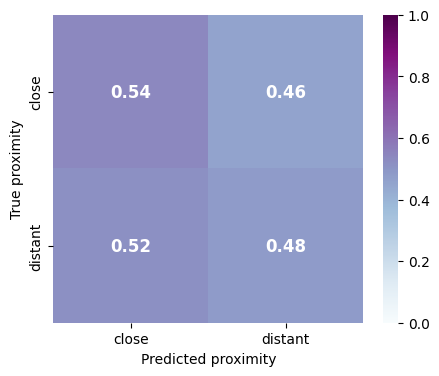

<IPython.core.display.Javascript object>

In [227]:
set_classic_style()

fig, ax = plot_cv_conf_mtx(
    dz_prox_confusion_matrix,
    n_folds=n_folds,
    annot_kws={"size": 12, "weight": "bold"},
    figsize=[5, 4],
)
ax.set_xlabel("Predicted proximity")
ax.set_ylabel("True proximity")
plt.title("")
plt.show()

The classifier does not achieves a classification accuracy signficantly higher than chance which is also shown in the quantification of the area under the ROC in the plot below. This implies that there are no signficant differences between chromatin organization and nuclear morphology of DZ B-cells depending on whether or not they are in close proximity to the border of the DZ/LZ boundary.

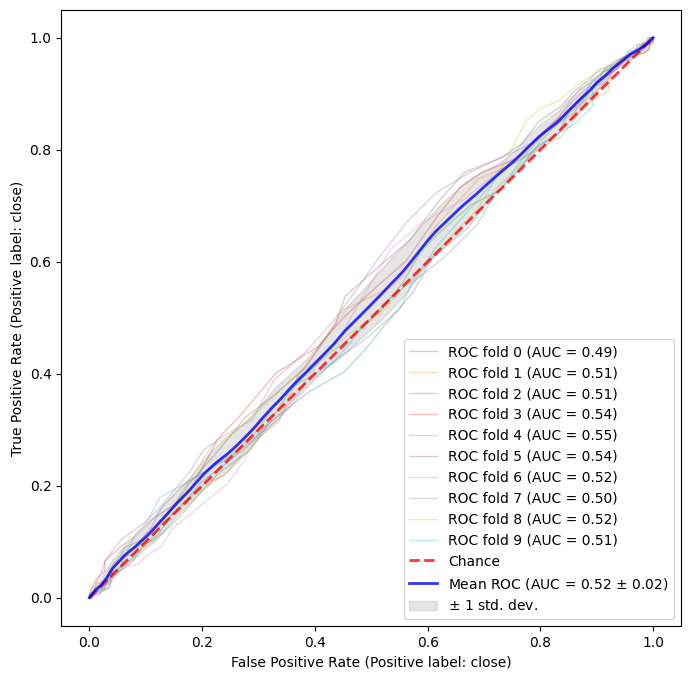

<IPython.core.display.Javascript object>

In [228]:
fig, ax, _ = plot_roc_for_stratified_cv(
    X=np.array(res_dz_bcell_prox_nuc_feats),
    y=np.array(res_dz_prox_labels),
    classifier=rfc,
    n_splits=n_folds,
    title="",
    random_state=seed,
    pos_label="close",
)

---

#### Discriminability of LZ B-cells close vs. distant to the boundary

We now run the same analysis but focus on the LZ B-cells this time.

In [229]:
lz_bcell_prox_nuc_feats = bcell_nuc_feats.loc[
    dlz_border_distance_df.loc[dlz_border_distance_df.cell_type == "LZ B-cells"].index
]
lz_prox_labels = dlz_border_distance_df.loc[
    lz_bcell_prox_nuc_feats.index, "border_proximity"
]

<IPython.core.display.Javascript object>

In [230]:
ru = RandomUnderSampler(random_state=seed)
res_lz_bcell_prox_nuc_feats, res_lz_prox_labels = ru.fit_resample(
    lz_bcell_prox_nuc_feats, lz_prox_labels
)
Counter(res_lz_prox_labels)

Counter({'close': 3165, 'distant': 3165})

<IPython.core.display.Javascript object>

In [231]:
rfc = RandomForestClassifier(
    n_estimators=100, n_jobs=8, class_weight="balanced", random_state=seed
)
n_folds = 10

<IPython.core.display.Javascript object>

In [232]:
fitted_lz_bcell_prox_rfcs, lz_prox_confusion_matrix = run_cv_evaluation(
    model=rfc,
    n_folds=n_folds,
    features=res_lz_bcell_prox_nuc_feats,
    labels=res_lz_prox_labels,
    random_state=seed,
)

<IPython.core.display.Javascript object>

In [233]:
cv_bacs = cross_val_score(
    rfc,
    cv=n_folds,
    X=res_lz_bcell_prox_nuc_feats,
    y=res_lz_prox_labels,
    scoring="balanced_accuracy",
    n_jobs=10,
)
print("Balanced accuracy: {} (+/- {})".format(np.mean(cv_bacs), np.std(cv_bacs)))

Balanced accuracy: 0.5759813121431139 (+/- 0.03269091045559894)


<IPython.core.display.Javascript object>

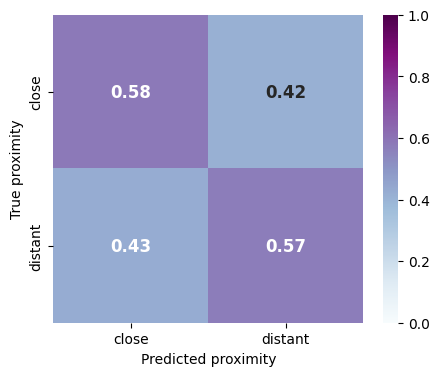

<IPython.core.display.Javascript object>

In [234]:
fig, ax = plot_cv_conf_mtx(
    lz_prox_confusion_matrix,
    n_folds=n_folds,
    annot_kws={"size": 12, "weight": "bold"},
    figsize=[5, 4],
)
ax.set_xlabel("Predicted proximity")
ax.set_ylabel("True proximity")
plt.title("")
plt.show()

The classifier can distinguish between LZ B-cells that are close and those that are distant to the DZ/LZ boundary signficantly than chance which is also backed by the assessment of the area under the ROC. This implies that the chromatin organization of the LZ B-cells differs for those that are closer to the boundary of the LZ/DZ.

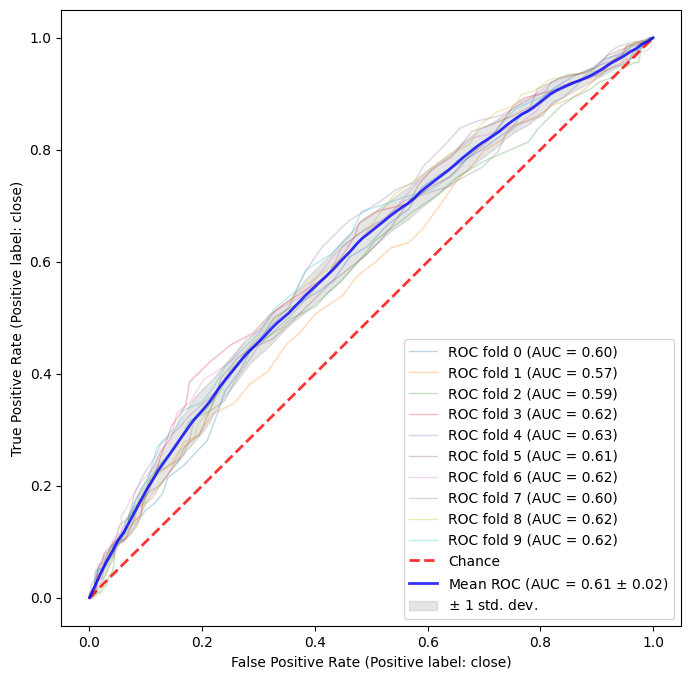

<IPython.core.display.Javascript object>

In [235]:
fig, ax, _ = plot_roc_for_stratified_cv(
    X=np.array(res_lz_bcell_prox_nuc_feats),
    y=np.array(res_lz_prox_labels),
    classifier=rfc,
    n_splits=n_folds,
    title="",
    random_state=seed,
    pos_label="close",
)

---

#### Assessment of the chrometric differences LZ B-cells close vs. distant to the LZ/DZ boundary

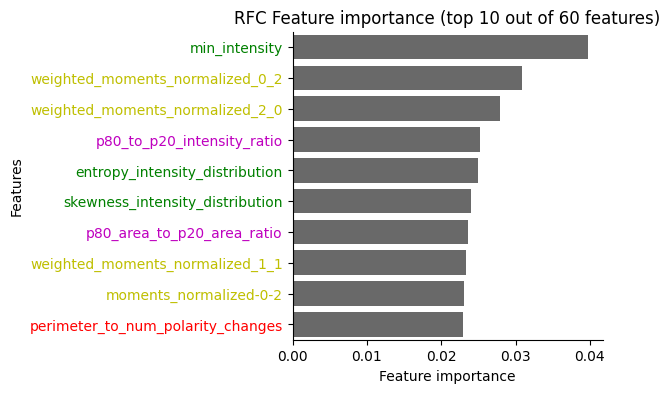

<IPython.core.display.Javascript object>

In [236]:
fitted_rfc = fitted_lz_bcell_prox_rfcs[0]
fig = plot_feature_importance(
    importance=fitted_rfc.feature_importances_,
    names=res_lz_bcell_prox_nuc_feats.columns,
    model_type="RFC ",
    n_features=10,
    figsize=[4, 4],
    feature_color_dict=feature_color_dict,
)

In [237]:
celltype_marker_results = find_markers(
    data=lz_bcell_prox_nuc_feats, labels=lz_prox_labels, test="welch"
)
lz_prox_marker_results = celltype_marker_results.loc[
    celltype_marker_results.label == "close"
]
lz_prox_marker_results = lz_prox_marker_results.loc[
    lz_prox_marker_results.adjusted_pval < 0.05
]
lz_prox_marker_results

Run marker screen: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  5.28it/s]


,label,marker,fc,abs_delta_fc,pval,adjusted_pval
11,close,min_intensity,1.213355,0.213355,3.551976e-81,2.131186e-79
21,close,weighted_moments_normalized_0_2,0.847388,0.152612,4.831768e-52,1.449530e-50
27,close,weighted_moments_normalized_2_2,0.768952,0.231048,2.571514e-25,5.143029e-24
14,close,entropy_intensity_distribution,1.022218,0.022218,1.037049e-22,1.555574e-21
25,close,weighted_moments_normalized_2_0,0.902085,0.097915,6.427498e-20,7.712998e-19
18,close,glcm_homogeneity_1px,0.972317,0.027683,1.917757e-14,1.917757e-13
15,close,p80_to_p20_intensity_ratio,0.983492,0.016508,1.531126e-10,1.312394e-09
40,close,weighted_moments_hu_1,0.795587,0.204413,4.194551e-08,3.145913e-07
46,close,moments_normalized-2-0,1.030078,0.030078,1.723541e-06,1.149027e-05
42,close,weighted_moments_hu_3,0.682264,0.317736,1.474446e-04,8.846676e-04


<IPython.core.display.Javascript object>

Interestingly, we find that the LZ B-cells that are in the proximity of the boundaries feature a more dark-zone like phenotype as we in particular observe an increased overall chromatin condensation in those cells. To show this we show that the prediction probability of the classifier to distinguish between DZ and LZ B-cells is significantly higher for LZ B-cells in the proximity of boundary.

In [238]:
gc_nuc_features.loc[
    dlz_border_distance_df.index, "border_proximity"
] = dlz_border_distance_df.loc[:, "border_proximity"]

bc_nuc_features = gc_nuc_features.loc[gc_nuc_features.cell_type.isin(["DZ B-cells", "LZ B-cells"])]

bc_nuc_features = add_kfold_predictions(
    data=bc_nuc_features,
    model=rfc,
    selected_features=list(bcell_nuc_feats.columns),
    label_col="cell_type",
    pos_label="DZ B-cells",
    n_folds=10
)

bc_nuc_features = add_kfold_predictions(
    data=bc_nuc_features,
    model=rfc,
    selected_features=list(bcell_nuc_feats.columns),
    label_col="cell_type",
    pos_label="LZ B-cells",
    n_folds=10
)


<IPython.core.display.Javascript object>

DZ B-cells_distant vs. DZ B-cells_close: Welch's t-test independent samples, P_val:9.667e-10 t=6.123e+00
LZ B-cells_distant vs. LZ B-cells_close: Welch's t-test independent samples, P_val:3.552e-81 t=-1.948e+01


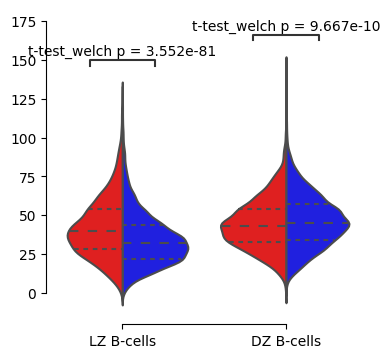

<IPython.core.display.Javascript object>

In [239]:
fig, ax = plt.subplots(figsize=[4, 4])
ax = sns.violinplot(
    data=bc_nuc_features,
    x="cell_type",
    y="min_intensity",
    hue="border_proximity",
    hue_order=["close", "distant"],
    palette=["r", "b"],
    split=True,
    inner="quartile",
    legend=False,
    ax=ax,
)
annotator = Annotator(
    ax,
    [
        (
            ("DZ B-cells", "close"),
            ("DZ B-cells", "distant"),
        ),
        (
            ("LZ B-cells", "close"),
            ("LZ B-cells", "distant"),
        ),
    ],
    data=bc_nuc_features,
    x="cell_type",
    y="min_intensity",
    hue="border_proximity",
    plot="violinplot",
)
# ax.legend(title="Proximity to LZ/DZ border")
ax.legend([], [], frameon=False)
annotator.configure(test="t-test_welch", text_format="full", loc="inside")
annotator.apply_and_annotate()
ax.set_ylabel("")
ax.set_xlabel("")
sns.despine(trim=True, offset=5)
plt.show()
plt.close()

DZ B-cells_distant vs. DZ B-cells_close: Welch's t-test independent samples, P_val:3.252e-06 t=-4.658e+00
LZ B-cells_distant vs. LZ B-cells_close: Welch's t-test independent samples, P_val:1.531e-10 t=6.416e+00


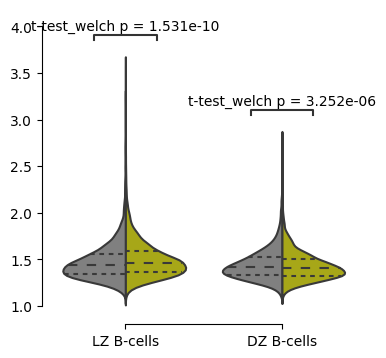

<IPython.core.display.Javascript object>

In [240]:
fig, ax = plt.subplots(figsize=[4, 4])
ax = sns.violinplot(
    data=bc_nuc_features,
    x="cell_type",
    y="p80_to_p20_intensity_ratio",
    hue="border_proximity",
    hue_order=["close", "distant"],
    palette=["gray", "y"],
    split=True,
    inner="quartile",
    legend=False,
    ax=ax,
)
annotator = Annotator(
    ax,
    [
        (
            ("DZ B-cells", "close"),
            ("DZ B-cells", "distant"),
        ),
        (
            ("LZ B-cells", "close"),
            ("LZ B-cells", "distant"),
        ),
    ],
    data=bc_nuc_features,
    x="cell_type",
    y="p80_to_p20_intensity_ratio",
    hue="border_proximity",
    plot="violinplot",
)
# ax.legend(title="Proximity to LZ/DZ border")
ax.legend([], [], frameon=False)
annotator.configure(test="t-test_welch", text_format="full", loc="inside")
annotator.apply_and_annotate()
ax.set_ylabel("")
ax.set_xlabel("")
sns.despine(trim=True, offset=5)
plt.show()
plt.close()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

DZ B-cells_distant vs. DZ B-cells_close: Welch's t-test independent samples, P_val:2.424e-07 t=5.169e+00
LZ B-cells_distant vs. LZ B-cells_close: Welch's t-test independent samples, P_val:5.023e-68 t=-1.771e+01


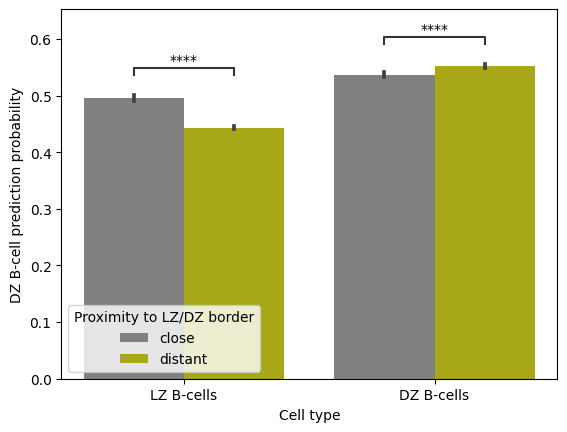

<IPython.core.display.Javascript object>

In [241]:
ax = sns.barplot(
    data=bc_nuc_features,
    x="cell_type",
    y="predicted_DZ B-cells_prob",
    hue="border_proximity",
    hue_order=["close", "distant"],
    palette=["gray", "y"],
)
annotator = Annotator(
    ax,
    [
        (
            ("DZ B-cells", "close"),
            ("DZ B-cells", "distant"),
        ),
        (
            ("LZ B-cells", "close"),
            ("LZ B-cells", "distant"),
        ),
    ],
    data=bc_nuc_features,
    x="cell_type",
    y="predicted_DZ B-cells_prob",
    hue="border_proximity",
    plot="barplot",
)
ax.legend(title="Proximity to LZ/DZ border")
annotator.configure(test="t-test_welch", text_format="star", loc="inside")
annotator.apply_and_annotate()
ax.set_ylabel("DZ B-cell prediction probability")
ax.set_xlabel("Cell type")
plt.show()
plt.close()

In [242]:
bc_nuc_features.loc[
    :, "frequency_based_distance_to_border"
] = dlz_border_distance_df.loc[
    bc_nuc_features.index, "frequency_based_distance_to_border"
]
bc_nuc_features.loc[:, "scaled_distance_to_border"] = dlz_border_distance_df.loc[
    bc_nuc_features.index, "scaled_distance_to_border"
]

<IPython.core.display.Javascript object>

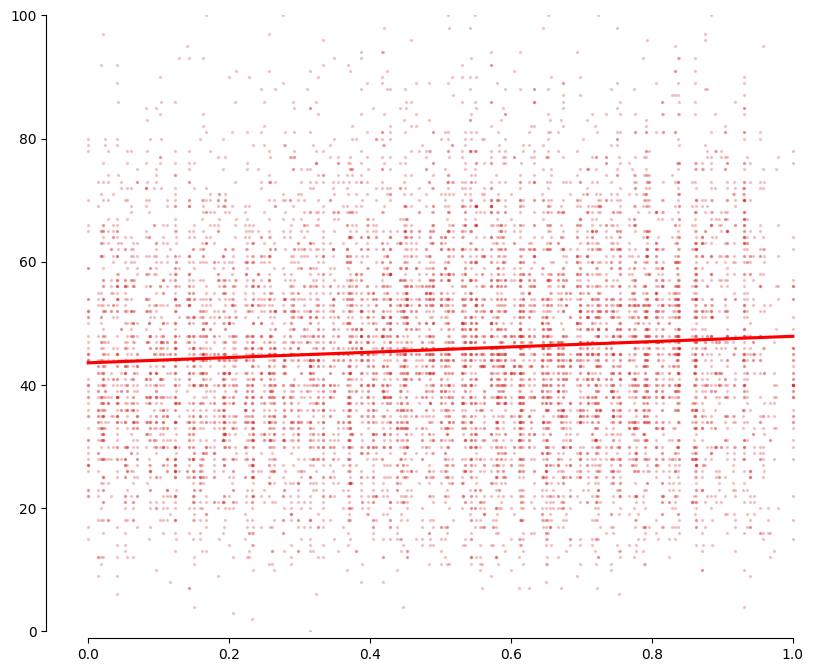

27 9197


<IPython.core.display.Javascript object>

In [243]:
fig, ax = plt.subplots(figsize=[10, 8])
sns.regplot(
    data=bc_nuc_features.loc[bc_nuc_features.cell_type == "DZ B-cells"],
    x="frequency_based_distance_to_border",
    y="min_intensity",
    ax=ax,
    color="r",
    ci=None,
    scatter_kws={"s": 2, "alpha": 0.2, "color": "tab:red"},
)
ax.set_xlabel("")
ax.set_ylabel("")
ax.set_ylim([0, 100])
sns.despine(trim=True, offset=5)

distance = np.array(
    bc_nuc_features.loc[
        bc_nuc_features.cell_type == "DZ B-cells",
        "frequency_based_distance_to_border",
    ]
)
min_ints = np.array(
    bc_nuc_features.loc[bc_nuc_features.cell_type == "DZ B-cells", "min_intensity"]
)
plt.show()
plt.close()
print(
    len(
        bc_nuc_features.loc[
            (bc_nuc_features.cell_type == "DZ B-cells")
            & (bc_nuc_features.min_intensity > 100)
        ]
    ),
    len(bc_nuc_features.loc[bc_nuc_features.cell_type == "DZ B-cells"]),
)

71 16182


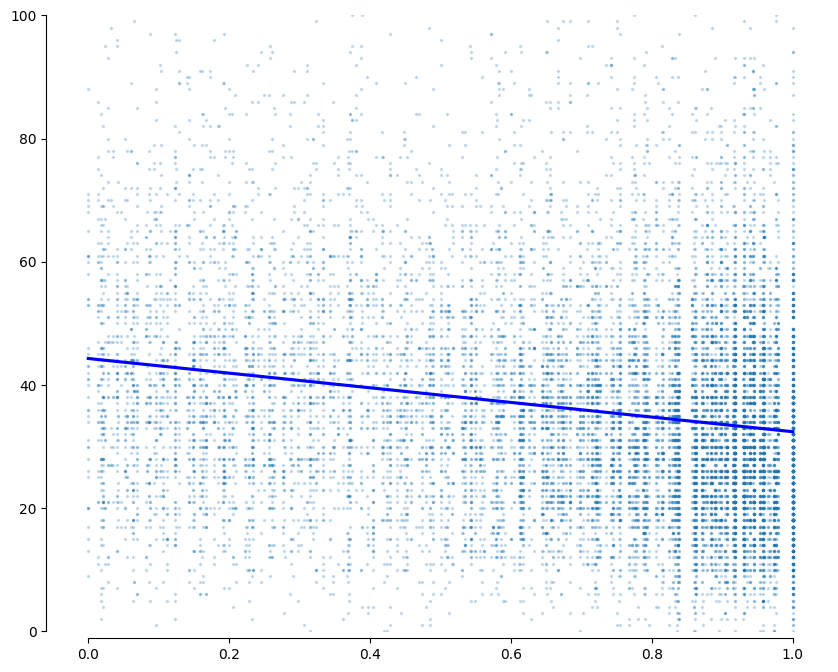

<IPython.core.display.Javascript object>

In [244]:
fig, ax = plt.subplots(figsize=[10, 8])
sns.regplot(
    data=bc_nuc_features.loc[bc_nuc_features.cell_type == "LZ B-cells"],
    x="frequency_based_distance_to_border",
    # y="predicted_DZ B-cells_prob",
    y="min_intensity",
    ax=ax,
    color="b",
    ci=None,
    # x_jitter=0.05,
    scatter_kws={"s": 2, "alpha": 0.2, "color": "tab:blue"},
)
ax.set_xlabel("")
ax.set_ylabel("")
ax.set_ylim([0, 100])
sns.despine(trim=True, offset=5)

distance = np.array(
    bc_nuc_features.loc[
        bc_nuc_features.cell_type == "LZ B-cells",
        "frequency_based_distance_to_border",
    ]
)
min_ints = np.array(
    bc_nuc_features.loc[bc_nuc_features.cell_type == "LZ B-cells", "min_intensity"]
)

print(
    len(
        bc_nuc_features.loc[
            (bc_nuc_features.cell_type == "LZ B-cells")
            & (bc_nuc_features.min_intensity > 100)
        ]
    ),
    len(bc_nuc_features.loc[bc_nuc_features.cell_type == "LZ B-cells"]),
)

plt.show()
plt.close()

(30.0, 50.0)

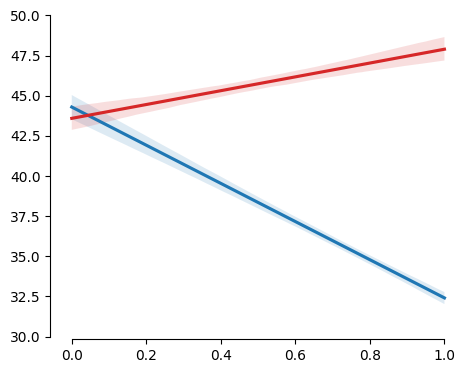

<IPython.core.display.Javascript object>

In [116]:
# fig, ax = plt.subplots(figsize=[9, 6])
g = sns.lmplot(
    data=bc_nuc_features,
    x="frequency_based_distance_to_border",
    # y="predicted_DZ B-cells_prob",
    y="min_intensity",
    # ax=ax,
    # color="red",
    # scatter_kws={"s": 2, "alpha": 0.5, "color": "tab:orange"},
    scatter=False,
    hue="cell_type",
    palette=["tab:blue", "tab:red"],
    facet_kws={"sharex": True, "sharey": True, "ylim": [30, 50]},
    legend=False,
    height=4,
    aspect=1.25,
    hue_order=["LZ B-cells", "DZ B-cells"],
)
sns.despine(offset=2, trim=True)
g.axes[0][0].set_xlabel("")
g.axes[0][0].set_ylabel("")
g.axes[0][0].set_xlabel("")
g.axes[0][0].set_ylim([30, 50])
# g.axes[0][0].legend(title="", loc="lower left", frameon=False)

In [ ]:
b = int(1e6)
dz_data = bc_nuc_features.loc[bc_nuc_features.cell_type == "DZ B-cells"]
dz_pp_min_int_vs_prox = permtest_pearsonr(
    np.array(dz_data.loc[:, "min_intensity"]),
    np.array(dz_data.loc[:, "frequency_based_distance_to_border"]),
    n_perm=b,
    seed=seed,
)
print(
    "DZ B-cells Pearson r for min intensity and proximity (r, p-value)",
    dz_pp_min_int_vs_prox,
)

In [ ]:
lz_data = bc_nuc_features.loc[bc_nuc_features.cell_type == "LZ B-cells"]
lz_pp_min_int_vs_prox = permtest_pearsonr(
    np.array(lz_data.loc[:, "min_intensity"]),
    np.array(lz_data.loc[:, "frequency_based_distance_to_border"]),
    n_perm=b,
    seed=seed,
)
print(
    "LZ B-cells Pearson r for min intensity and proximity (r, p-value)",
    lz_pp_min_int_vs_prox,
)

---

#### Assess chromatin organization of B-cells in germinal centers and their distance to T-cells.

We finally assess if the chromatin organization of B-cells is different depending on their proximity to T-cells. In particular, we check if the different levels of overall chromatin condensation correlates with the mean or median distance of a B-cell to all T-cells in the germinal center, respectively with respect to the distance to the nearest T-cell.

To this end, we first compute the distance matrix for all cells to the corresponding T-cells in the different germinal centers. Note that we thereby range-normalize the distances for each germinal center individually to account for the different sizes and cell density in those germinal centers.

In [276]:
from scipy.spatial.distance import squareform, pdist


def get_distances_to_tcells(
    dataset,
    tcell_label="t_cells",
    cell_type_col="type",
    id_col="nuc_id",
    range_norm=True,
):
    image_ids = dataset["image"].unique()
    grouped = dataset.groupby(dataset.image)
    tcell_dists = []
    for i in range(len(image_ids)):
        data = grouped.get_group(image_ids[i])
        cell_type_labels = np.array(data.loc[:, cell_type_col])
        ids = np.array(data.loc[:, id_col])
        cell_dist_df = pd.DataFrame(
            squareform(pdist(data.loc[:, ["spat_centroid_y", "spat_centroid_x"]])),
            index=ids,
            columns=ids,
        )
        if range_norm:
            cell_dist_df = (cell_dist_df - np.min(cell_dist_df)) / (
                np.max(cell_dist_df) - np.min(cell_dist_df)
            )

        tcell_dists.append(cell_dist_df.loc[:, cell_type_labels == tcell_label])
    return image_ids, tcell_dists

<IPython.core.display.Javascript object>

In [277]:
image_ids, tcell_dists = get_distances_to_tcells(
    dataset=gc_nuc_features,
    tcell_label="T-cells",
    cell_type_col="cell_type",
    id_col="nuc_id",
    range_norm=True,
)
tcell_dist_summaries = []
for tcell_dist in tcell_dists:
    tcell_dist_summary = {}
    tcell_dist_summary["tcell_mean_distance"] = np.mean(tcell_dist, axis=1)
    tcell_dist_summary["tcell_median_distance"] = np.median(tcell_dist, axis=1)
    tcell_dist_summary["tcell_min_distance"] = np.min(tcell_dist, axis=1)
    tcell_dist_summaries.append(
        pd.DataFrame(tcell_dist_summary, index=tcell_dist.index)
    )
tcell_distances = pd.concat(tcell_dist_summaries)
tcell_distances.describe()

,tcell_mean_distance,tcell_median_distance,tcell_min_distance
count,28819.000000,28819.000000,28819.000000
mean,0.532667,0.568717,0.047287
std,0.115234,0.150785,0.041929
min,0.314449,0.263233,0.000000
25%,0.439781,0.444489,0.019255
50%,0.520462,0.552410,0.036040
75%,0.616285,0.681451,0.064263
max,0.924848,0.998511,0.424415


<IPython.core.display.Javascript object>

In [278]:
tmp = gc_nuc_features.join(tcell_distances, how="inner")
tmp2 = bc_nuc_features.join(tcell_distances, how="inner")

<IPython.core.display.Javascript object>

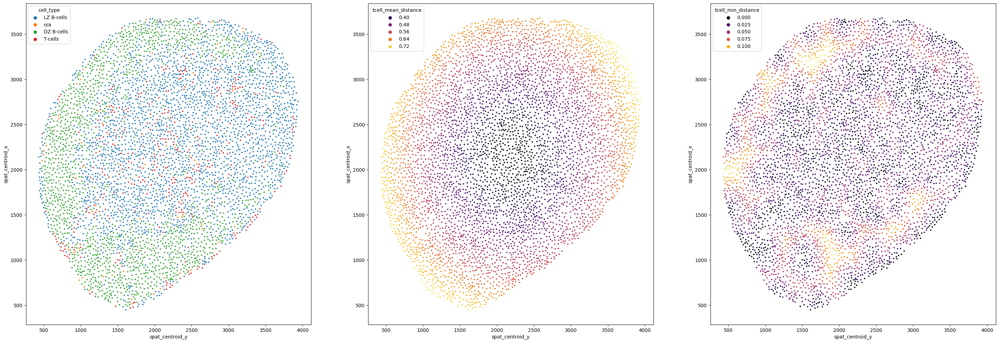

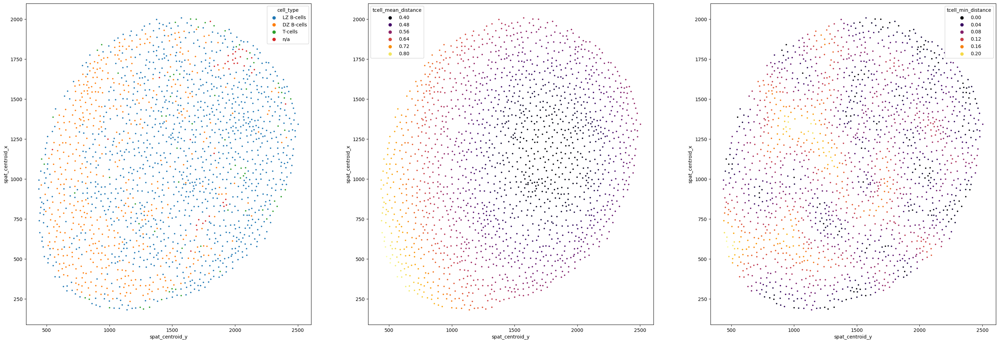

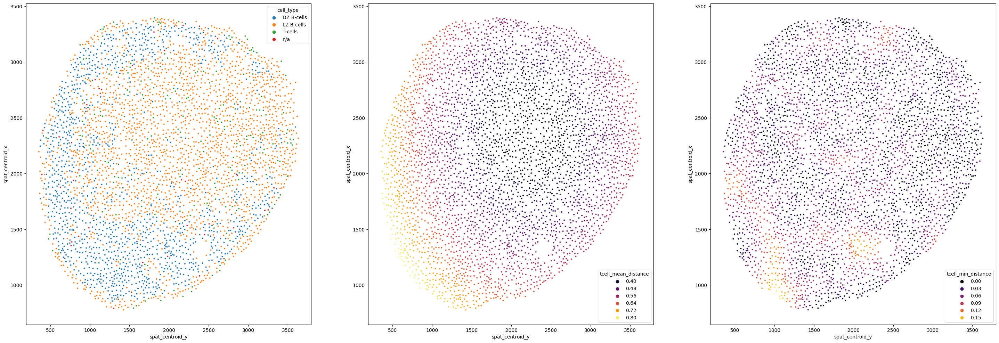

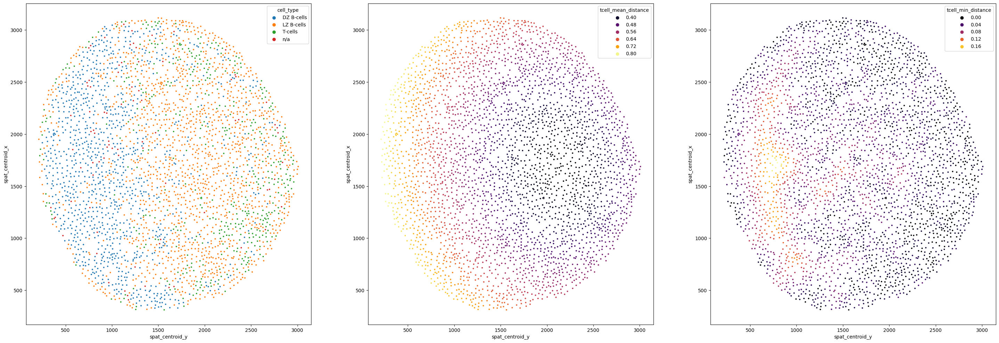

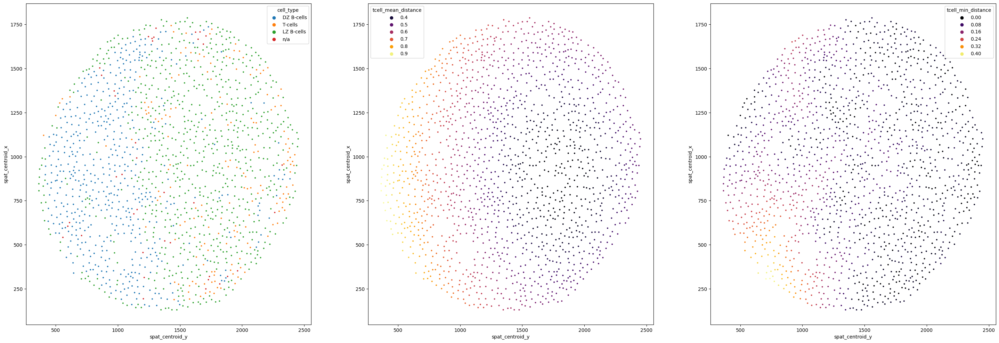

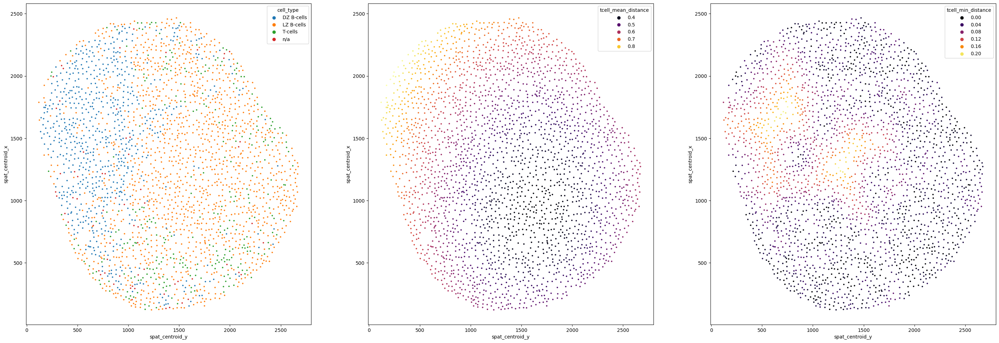

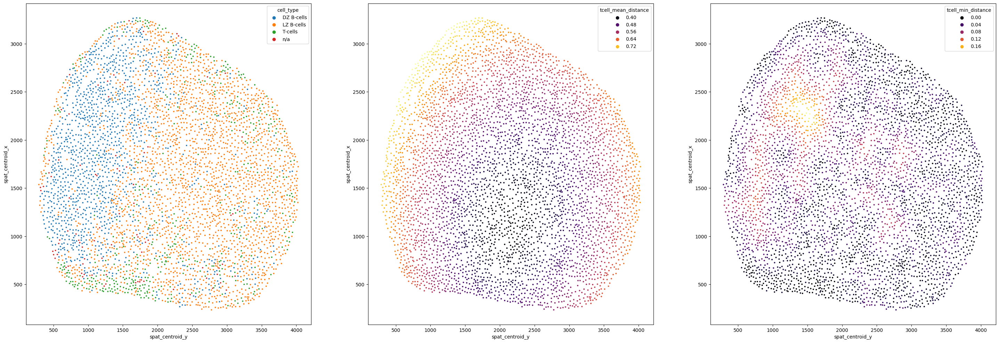

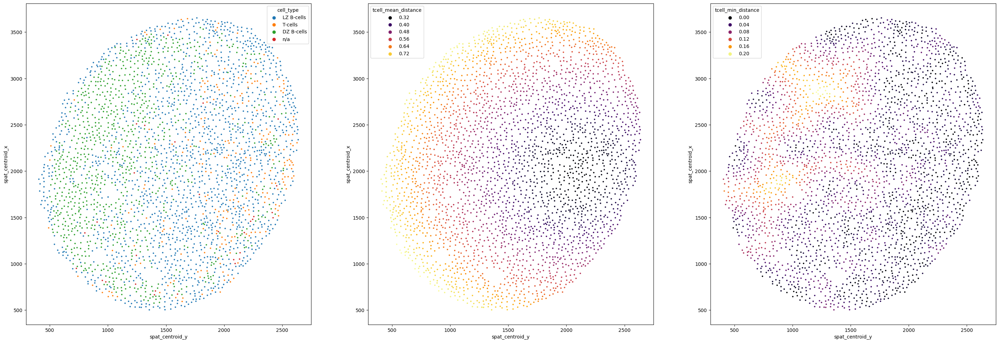

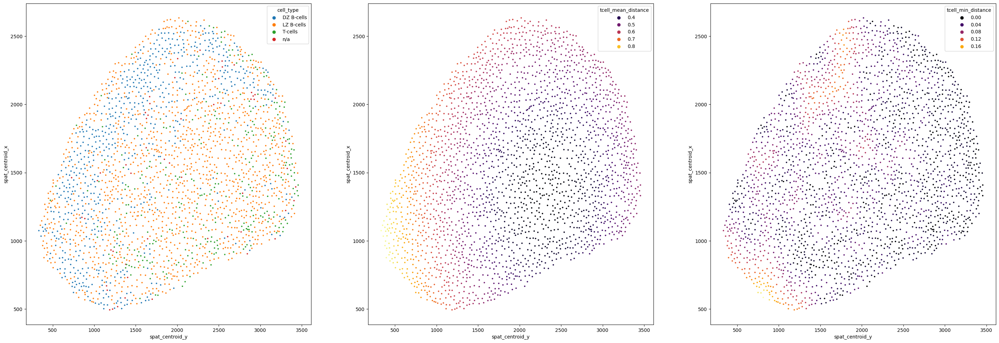

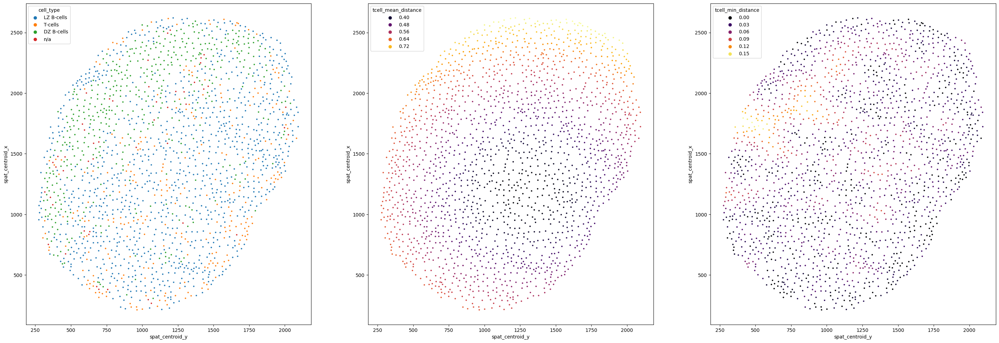

<IPython.core.display.Javascript object>

In [279]:
plt.style.use("default")

for image in np.unique(tmp2.image):
    fig, ax = plt.subplots(figsize=[36, 12], ncols=3)
    ax[0] = sns.scatterplot(
        data=tmp.loc[tmp.image == image],
        x="spat_centroid_y",
        y="spat_centroid_x",
        hue="cell_type",
        ax=ax[0],
        s=10,
    )
    ax[1] = sns.scatterplot(
        data=tmp.loc[tmp.image == image],
        x="spat_centroid_y",
        y="spat_centroid_x",
        hue="tcell_mean_distance",
        ax=ax[1],
        s=10,
        palette="inferno",
    )
    ax[2] = sns.scatterplot(
        data=tmp.loc[tmp.image == image],
        x="spat_centroid_y",
        y="spat_centroid_x",
        hue="tcell_min_distance",
        ax=ax[2],
        s=10,
        palette="inferno",
    )

We next compute the median, and mean distance for each cell to all T-cells as well as the closest euclidean distance to a T-cell.

Note that so far the distance matrix does not only include LZ/DZ B-cells but also T-cells.
To look for a correlation with any of the identified chrometric features, we will now add these metrics to the chrometric features of the B-cells.

In [287]:
bc_nuc_features = bc_nuc_features.join(tcell_distances, how="inner")

<IPython.core.display.Javascript object>

---

###### Correlation with the mean distance

We first check if the previously identified minimum DNA intensity as a measure for the overall chromatin condensation is correlated with the average distance of a B-cell to all T-cells in the germinal center. To account for the different density of T-cells in the LZ and DZ of the germinal center, we will also assess the correlation individually for those two zones.

In [292]:
min_int_vs_mean_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_mean_distance",
    cell_type=None,
    b=1e6,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_mean_distance (r, p-value) (0.34096232643610286, 9.99999000001e-07)


<IPython.core.display.Javascript object>

In [293]:
dz_bcells_min_int_vs_mean_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_mean_distance",
    cell_type="DZ B-cells",
    b=1e6,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_mean_distance (r, p-value) (0.2029847909441671, 9.99999000001e-07)


<IPython.core.display.Javascript object>

In [294]:
lz_bcells_min_int_vs_mean_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_mean_distance",
    cell_type="LZ B-cells",
    b=1e6,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_mean_distance (r, p-value) (0.2998272848797511, 9.99999000001e-07)


<IPython.core.display.Javascript object>

---

###### Correlation with the median distance

In [295]:
min_int_vs_median_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_median_distance",
    cell_type=None,
    b=1e4,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_median_distance (r, p-value) (0.3091469648567859, 9.999000099990002e-05)


<IPython.core.display.Javascript object>

In [296]:
dz_bcells_min_int_vs_median_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_median_distance",
    cell_type="DZ B-cells",
    b=1e4,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_median_distance (r, p-value) (0.18125053517789882, 9.999000099990002e-05)


<IPython.core.display.Javascript object>

In [297]:
lz_bcells_min_int_vs_median_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_median_distance",
    cell_type="LZ B-cells",
    b=1e4,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_median_distance (r, p-value) (0.2639340582539544, 9.999000099990002e-05)


<IPython.core.display.Javascript object>

---

###### Correlation with the median distance

In [229]:
min_int_vs_min_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_min_distance",
    cell_type=None,
    b=1e4,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_min_distance (r, p-value) (-0.07929669127960896, 9.999000099990002e-05)


<IPython.core.display.Javascript object>

In [230]:
dz_bcells_min_int_vs_min_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_min_distance",
    cell_type="DZ B-cells",
    b=1e4,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_min_distance (r, p-value) (-0.06847784630228965, 9.999000099990002e-05)


<IPython.core.display.Javascript object>

In [231]:
lz_bcells_min_int_vs_min_tcell_dist_pearson = test_correlation(
    bc_nuc_features,
    x_col="min_intensity",
    y_col="tcell_min_distance",
    cell_type="LZ B-cells",
    b=1e4,
    seed=1234,
    verbose=True,
)

Pearson r for min_intensity and tcell_min_distance (r, p-value) (-0.09396395307786218, 9.999000099990002e-05)


<IPython.core.display.Javascript object>

---

Finally, we plot the regression lines for the minimum DNA intensity and the mean distance to the T-cell neighbors for all B-cells (gray), the DZ B-cells (red) and the LZ

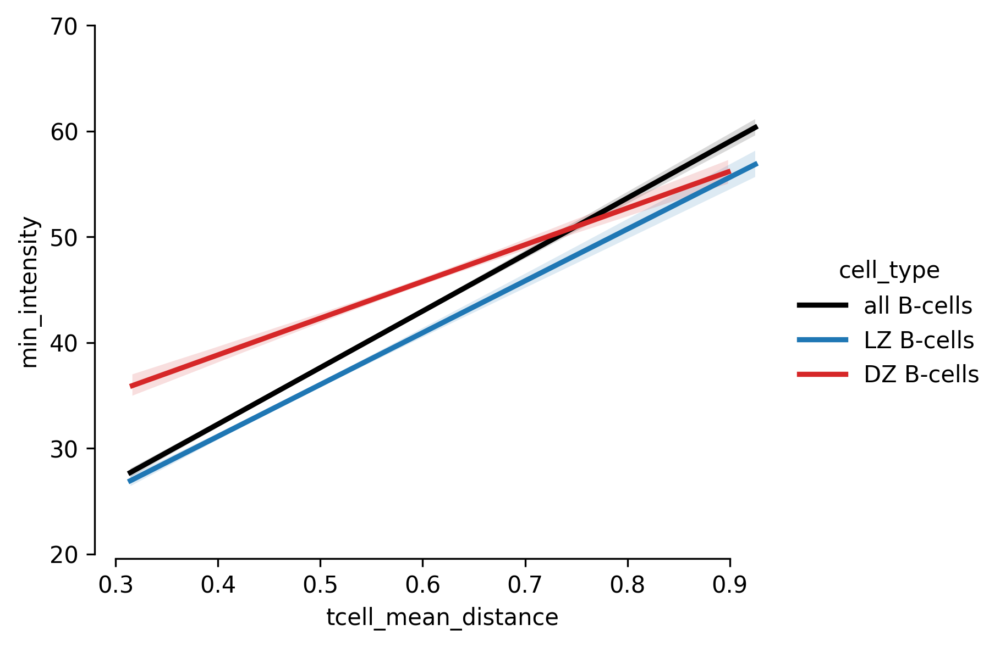

<IPython.core.display.Javascript object>

In [303]:
tmp1 = bc_nuc_features.loc[
    :, ["cell_type", "min_intensity", "tcell_mean_distance"]
].copy()
tmp2 = bc_nuc_features.loc[:, ["min_intensity", "tcell_mean_distance"]].copy()
tmp2["cell_type"] = "all B-cells"
tmp = tmp1.append(tmp2)

g = sns.lmplot(
    data=tmp,
    x="tcell_mean_distance",
    y="min_intensity",
    scatter=False,
    hue="cell_type",
    hue_order=["all B-cells", "LZ B-cells", "DZ B-cells"],
    palette=["k", "tab:blue", "tab:red"],
    facet_kws={"sharex": True, "sharey": True, "ylim": [20, 70]},
    legend=True,
    height=4,
    aspect=1.25,
)
sns.despine(offset=2, trim=True)
# g.axes[0][0].set_ylim([0.20, 70])
# g.axes[0][0].set_xlim([0.0, 1.0])

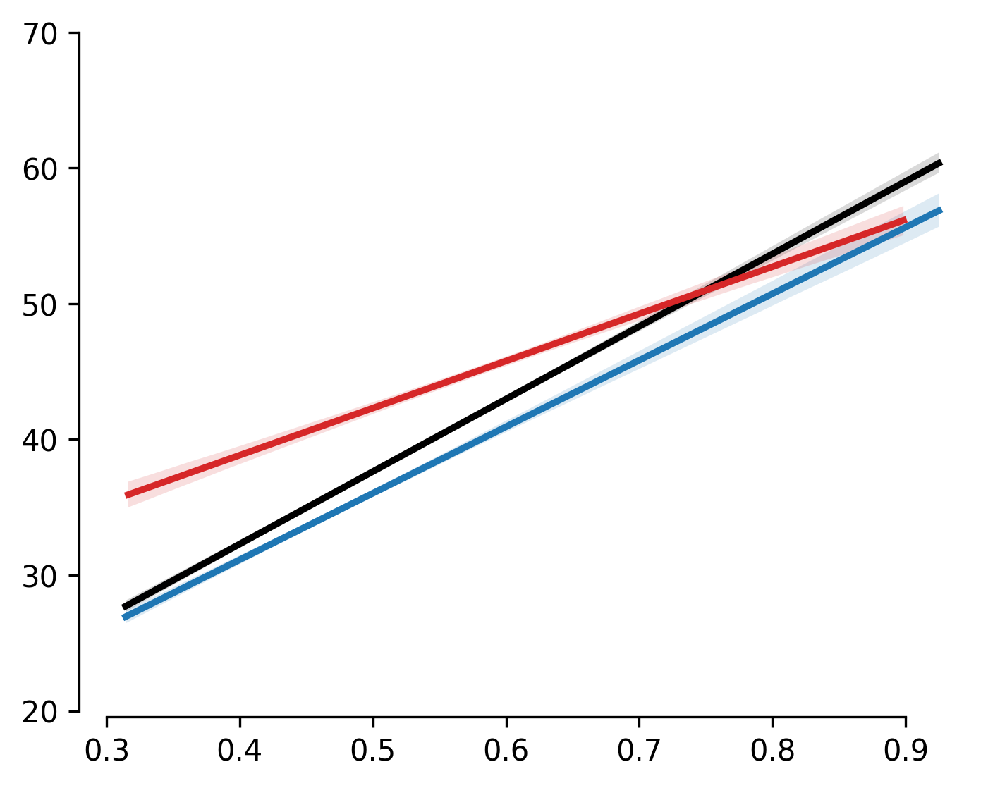

<IPython.core.display.Javascript object>

In [305]:
g = sns.lmplot(
    data=tmp,
    x="tcell_mean_distance",
    y="min_intensity",
    scatter=False,
    hue="cell_type",
    hue_order=["all B-cells", "LZ B-cells", "DZ B-cells"],
    palette=["k", "tab:blue", "tab:red"],
    facet_kws={"sharex": True, "sharey": True, "ylim": [20, 70]},
    legend=False,
    height=4,
    aspect=1.25,
)

g.axes[0][0].set_ylabel("")
g.axes[0][0].set_xlabel("")
sns.despine(offset=2, trim=True)

---

#### Summary

Jointly, those findings suggest that the in particular the B-cells at the boundary of the LZ and DZ show chromatin organization and nuclear morphology more similar to the DZ B-cells i.e. suggest that the mechanical state of those prevents the DZ from being infiltrated by T-cells.

In [113]:
1 / (1e6 + 1)

9.99999000001e-07

<IPython.core.display.Javascript object>